In [33]:
# Step 1: Import necessary libraries
import os
import numpy as np
import matplotlib.pyplot as plt
from skimage.feature import hog
from skimage import io, color
import requests


In [37]:
# Step 2: Import the custom script for downloading and extracting images
# If your `extract_images.py` file is in the same folder, you can import the functions here
from extract_images import download_and_extract_zip, get_image_paths

In [39]:
# Step 3: Function for HOG feature extraction
def extract_hog_features(image_path):
    # Load the image
    image = io.imread(image_path)
    
    # Convert the image to grayscale if it’s a color image
    if len(image.shape) == 3:
        image = color.rgb2gray(image)
    
    # Extract HOG features and the HOG image
    features, hog_image = hog(image, pixels_per_cell=(8, 8), cells_per_block=(2, 2), visualize=True)
    
    return features, hog_image

In [41]:
# Step 4: Function to test the feature extraction process on multiple images
def test_feature_extraction(image_paths):
    for path in image_paths:
        # Check if the file exists
        if os.path.exists(path):
            features, hog_image = extract_hog_features(path)
            # Display the HOG image
            plt.imshow(hog_image, cmap=plt.cm.gray)
            plt.title(f'HOG Features for {path}')
            plt.show()
            # Print a portion of the feature vector
            print(f"Feature vector for {path}:", features[:10])  # Show first 10 features for brevity
        else:
            print(f"File not found: {path}")

In [5]:
# Step 5: Download and extract images from the provided URL (first-time setup)
# This is only needed once, so you can comment this out after the first run
url = 'https://download.microsoft.com/download/3/E/1/3E1C3F21-ECDB-4869-8368-6DEBA77B919F/kagglecatsanddogs_5340.zip'
extraction_dir = 'images/'  # Folder where images will be extracted

# Uncomment the line below to run it once and download/extract the files
#download_and_extract_zip(url, extraction_dir)

Downloaded ZIP file to images/kagglecatsanddogs_5340.zip
Extracting ZIP file to images/...
Extracted files to images/


In [17]:
# Step 6: Get the list of image paths


Extracted image paths: []


In [27]:
import os

def get_image_paths(directory):
    image_paths = []
    valid_extensions = ['.jpg', '.jpeg', '.png', '.gif', '.bmp']

    # Walk through the 'PetImages' folder and its subdirectories ('Cat', 'Dog')
    for root, dirs, files in os.walk(directory):
        for file in files:
            if file.startswith('.'):  # Skip hidden files
                continue
            if any(file.lower().endswith(ext) for ext in valid_extensions):
                image_paths.append(os.path.join(root, file))

    return image_paths


In [29]:
extraction_dir = 'images/PetImages'  # Path to 'PetImages' folder
image_paths = get_image_paths(extraction_dir)
print(f"Extracted image paths: {image_paths}")


Extracted image paths: ['images/PetImages\\Cat\\0.jpg', 'images/PetImages\\Cat\\1.jpg', 'images/PetImages\\Cat\\10.jpg', 'images/PetImages\\Cat\\100.jpg', 'images/PetImages\\Cat\\1000.jpg', 'images/PetImages\\Cat\\10000.jpg', 'images/PetImages\\Cat\\10001.jpg', 'images/PetImages\\Cat\\10002.jpg', 'images/PetImages\\Cat\\10003.jpg', 'images/PetImages\\Cat\\10004.jpg', 'images/PetImages\\Cat\\10005.jpg', 'images/PetImages\\Cat\\10006.jpg', 'images/PetImages\\Cat\\10007.jpg', 'images/PetImages\\Cat\\10008.jpg', 'images/PetImages\\Cat\\10009.jpg', 'images/PetImages\\Cat\\1001.jpg', 'images/PetImages\\Cat\\10010.jpg', 'images/PetImages\\Cat\\10011.jpg', 'images/PetImages\\Cat\\10012.jpg', 'images/PetImages\\Cat\\10013.jpg', 'images/PetImages\\Cat\\10014.jpg', 'images/PetImages\\Cat\\10015.jpg', 'images/PetImages\\Cat\\10016.jpg', 'images/PetImages\\Cat\\10017.jpg', 'images/PetImages\\Cat\\10018.jpg', 'images/PetImages\\Cat\\10019.jpg', 'images/PetImages\\Cat\\1002.jpg', 'images/PetImages\\C

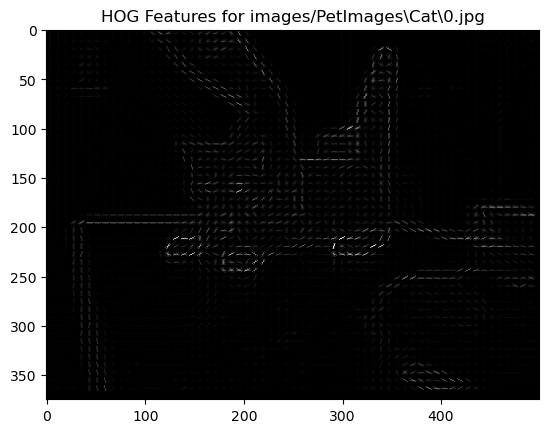

Feature vector for images/PetImages\Cat\0.jpg: [0.48281494 0.05968933 0.05662627 0.         0.01334694 0.
 0.         0.         0.         0.48281494]


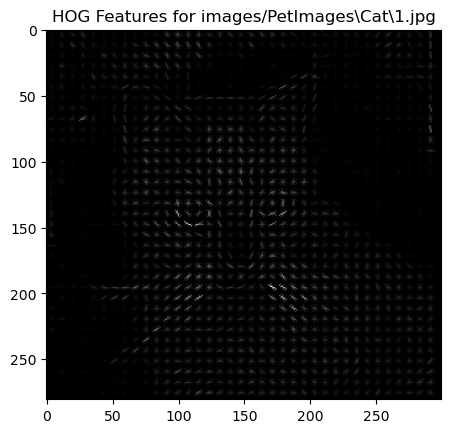

Feature vector for images/PetImages\Cat\1.jpg: [0.24019126 0.03415626 0.0371203  0.08201762 0.13147586 0.09358184
 0.         0.01821867 0.14428849 0.29971282]


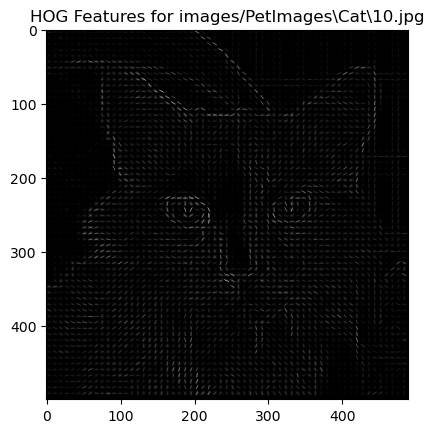

Feature vector for images/PetImages\Cat\10.jpg: [0.27150706 0.02062887 0.22436128 0.27150706 0.27150706 0.27150706
 0.27150706 0.02314546 0.04439482 0.27150706]


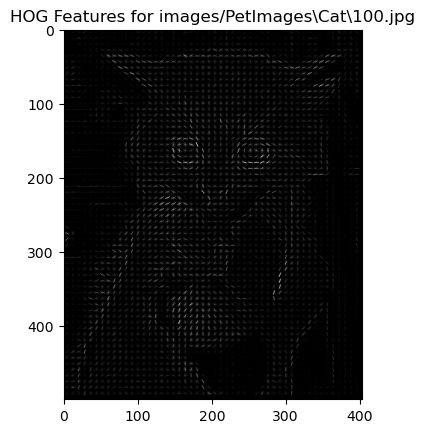

Feature vector for images/PetImages\Cat\100.jpg: [0.14316586 0.         0.03226199 0.02000804 0.20580092 0.06831171
 0.15185033 0.06002411 0.         0.23264975]


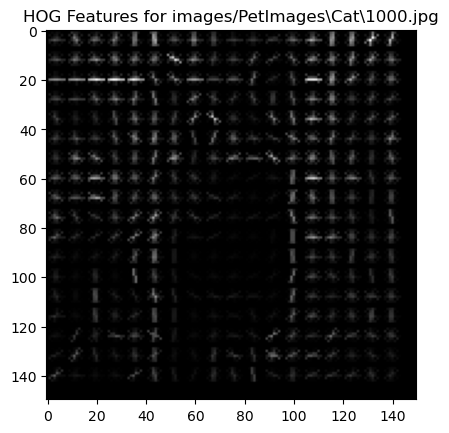

Feature vector for images/PetImages\Cat\1000.jpg: [0.14092988 0.09004919 0.13421287 0.10273796 0.24811174 0.11093965
 0.0539646  0.10553402 0.04951956 0.24811174]


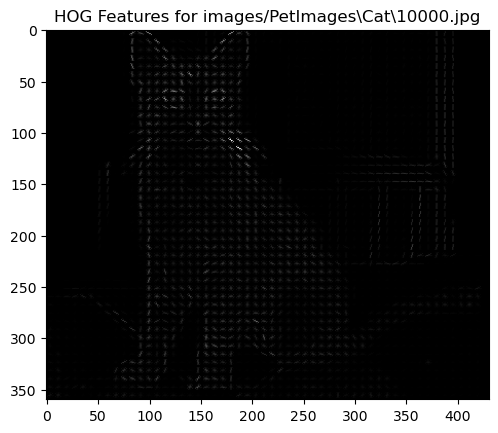

Feature vector for images/PetImages\Cat\10000.jpg: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


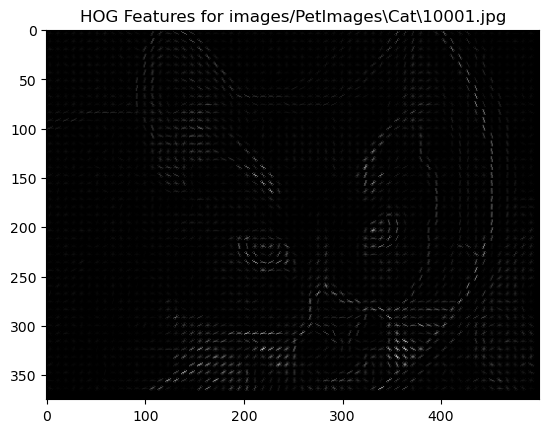

Feature vector for images/PetImages\Cat\10001.jpg: [0.23144056 0.22053516 0.06182065 0.12748631 0.23144056 0.1826976
 0.06672422 0.12243758 0.03980898 0.23144056]


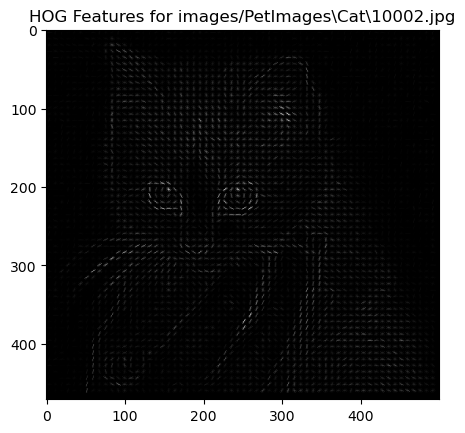

Feature vector for images/PetImages\Cat\10002.jpg: [0.32245827 0.09890017 0.03127498 0.14079835 0.34755768 0.12986156
 0.12509992 0.07417513 0.06993299 0.34755768]


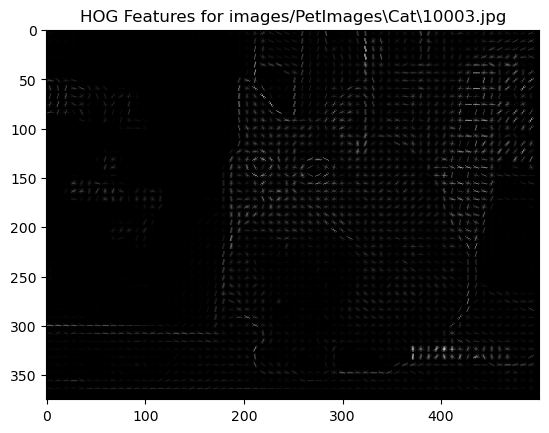

Feature vector for images/PetImages\Cat\10003.jpg: [0.2630903  0.2630903  0.25944874 0.11210246 0.19665048 0.25572505
 0.07174055 0.16727508 0.07820997 0.2630903 ]


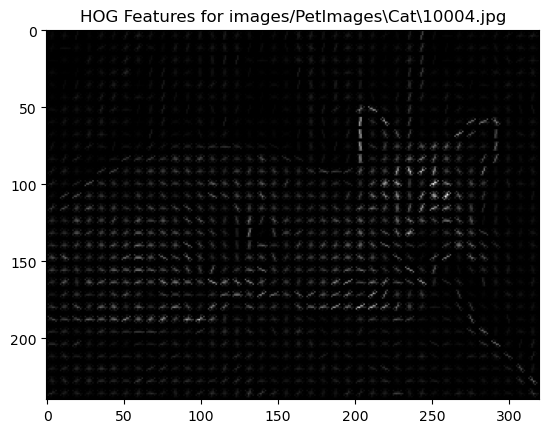

Feature vector for images/PetImages\Cat\10004.jpg: [0.2815287  0.24427006 0.11249032 0.07554319 0.10430789 0.02212609
 0.0668168  0.19311012 0.25592119 0.2815287 ]


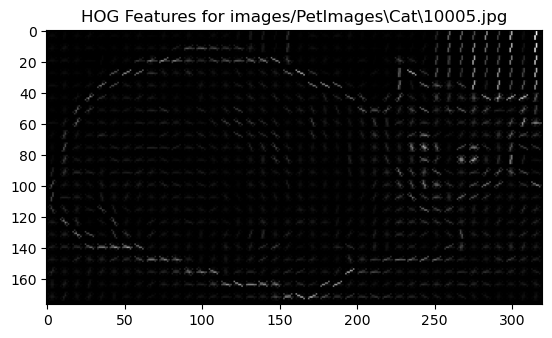

Feature vector for images/PetImages\Cat\10005.jpg: [0.15097408 0.05104303 0.14049954 0.2352916  0.20958239 0.2352916
 0.11557587 0.09888259 0.03810105 0.2352916 ]


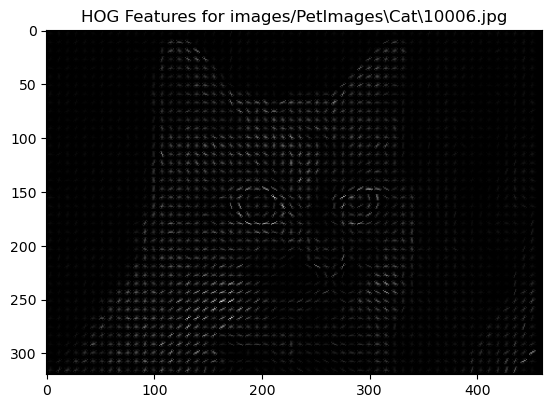

Feature vector for images/PetImages\Cat\10006.jpg: [0.14840024 0.17526808 0.18507959 0.20854824 0.23003575 0.09958789
 0.1650901  0.06403899 0.07322391 0.23003575]


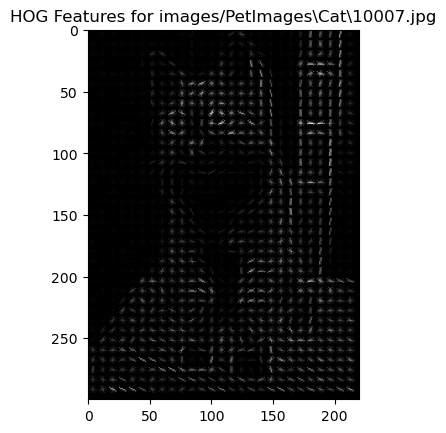

Feature vector for images/PetImages\Cat\10007.jpg: [0.24711174 0.05338029 0.06612139 0.0114639  0.24711174 0.
 0.18426327 0.12589414 0.0371474  0.24711174]


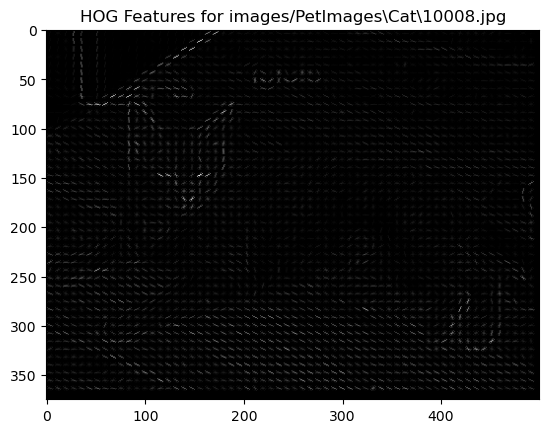

Feature vector for images/PetImages\Cat\10008.jpg: [0.38284185 0.         0.         0.         0.         0.
 0.         0.         0.         0.38284185]


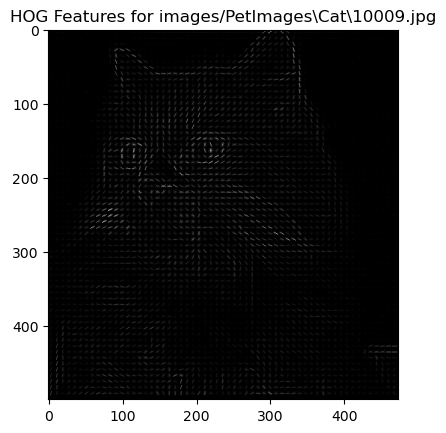

Feature vector for images/PetImages\Cat\10009.jpg: [0.22369442 0.         0.14060073 0.         0.24854935 0.05557732
 0.34040395 0.         0.         0.34040395]


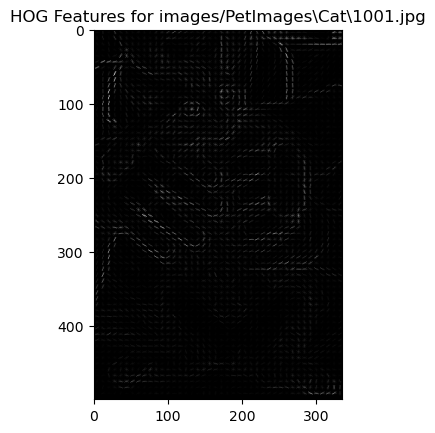

Feature vector for images/PetImages\Cat\1001.jpg: [0.15614948 0.05155031 0.01003211 0.07734963 0.2861152  0.1024934
 0.05440241 0.07185117 0.0860277  0.39413124]


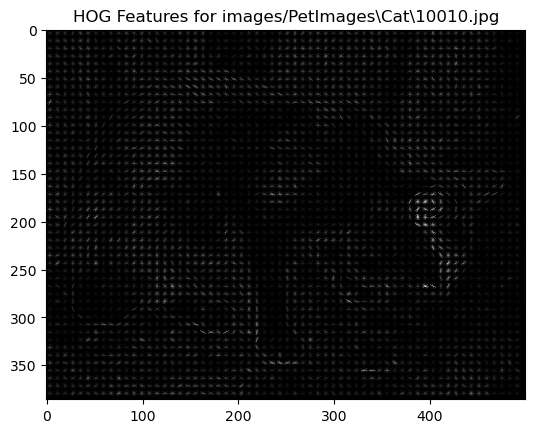

Feature vector for images/PetImages\Cat\10010.jpg: [0.2142543  0.18621386 0.11327451 0.04963781 0.10752862 0.11418538
 0.16788737 0.08827484 0.12552643 0.21761168]


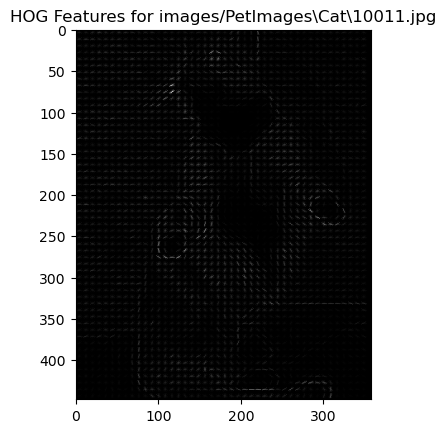

Feature vector for images/PetImages\Cat\10011.jpg: [0.14513887 0.05035814 0.10658032 0.18038097 0.25119578 0.19251135
 0.12141113 0.04245122 0.08242573 0.14391832]


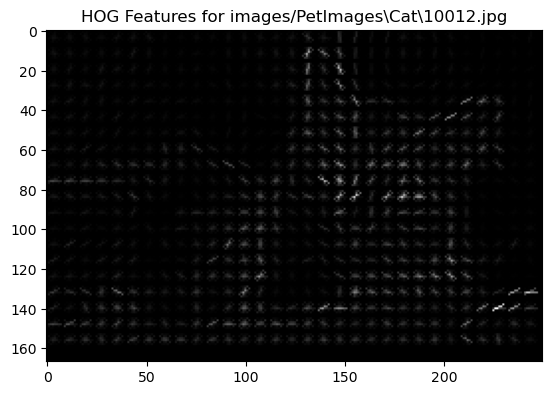

Feature vector for images/PetImages\Cat\10012.jpg: [0.22909386 0.15629768 0.04419572 0.10634399 0.22736234 0.15498185
 0.15238776 0.22238547 0.05030247 0.22589774]


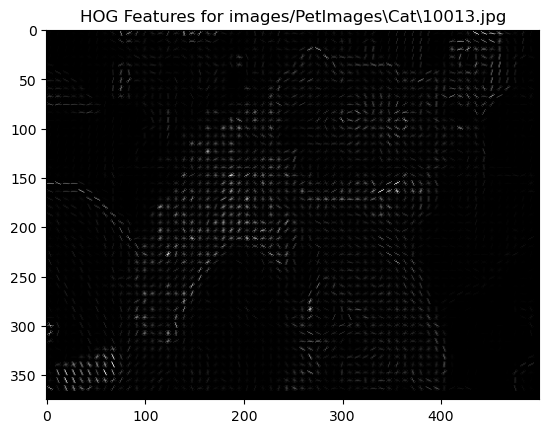

Feature vector for images/PetImages\Cat\10013.jpg: [0.50122299 0.         0.         0.         0.         0.
 0.         0.         0.         0.50122299]


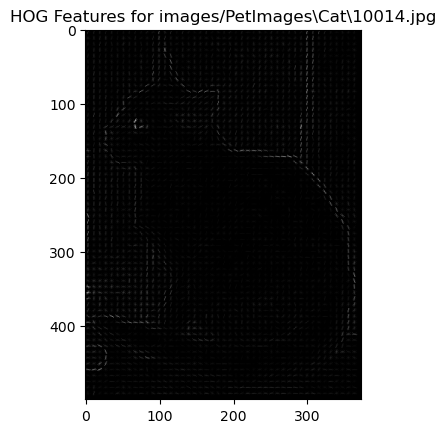

Feature vector for images/PetImages\Cat\10014.jpg: [0.31786615 0.12481075 0.05370258 0.         0.14368886 0.01558019
 0.03277904 0.         0.10134809 0.31786615]


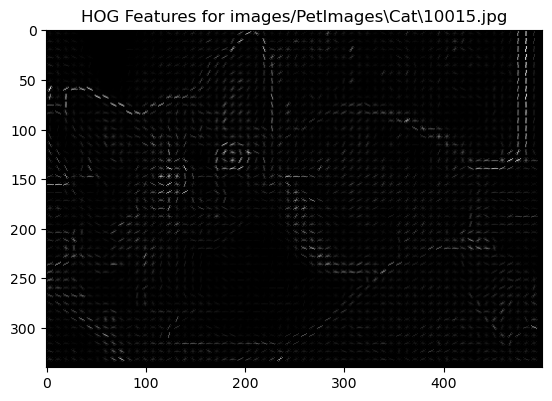

Feature vector for images/PetImages\Cat\10015.jpg: [0.24916208 0.05399309 0.04931969 0.02681073 0.17005955 0.06140752
 0.07765904 0.15625551 0.24916208 0.1894781 ]


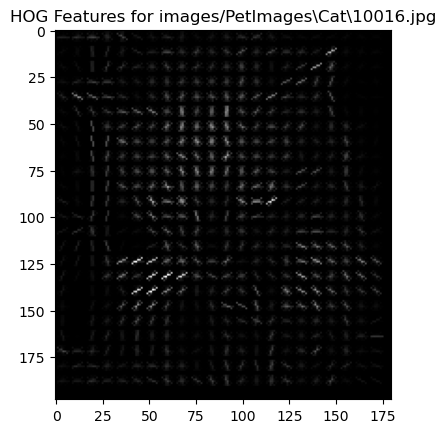

Feature vector for images/PetImages\Cat\10016.jpg: [0.10350354 0.03884012 0.10598793 0.21671314 0.37418336 0.21994485
 0.02544327 0.00692833 0.02072209 0.25637571]


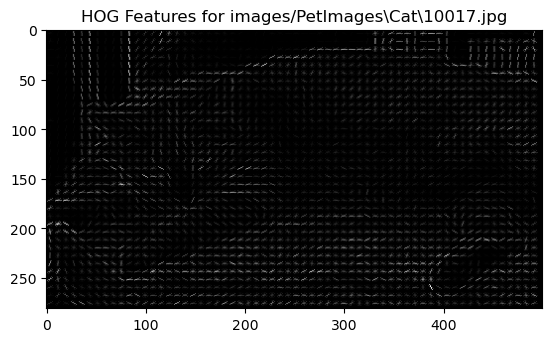

Feature vector for images/PetImages\Cat\10017.jpg: [0.22732457 0.19119973 0.35414085 0.15884786 0.26994793 0.03176957
 0.19187679 0.18580498 0.08985792 0.35414085]


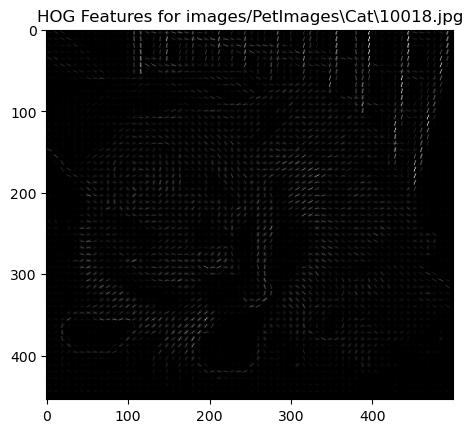

Feature vector for images/PetImages\Cat\10018.jpg: [0.11086767 0.00639121 0.00903586 0.02542844 0.10429877 0.13543057
 0.33471862 0.06373382 0.01164748 0.29482362]


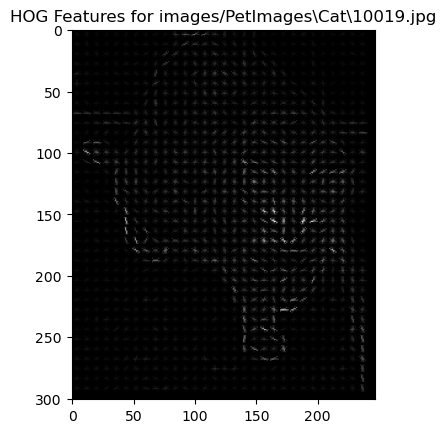

Feature vector for images/PetImages\Cat\10019.jpg: [0.12476884 0.0906907  0.05307967 0.07801117 0.14874681 0.23981481
 0.1260073  0.23981481 0.08186137 0.23981481]


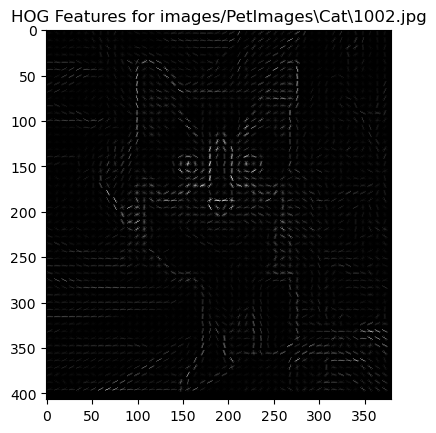

Feature vector for images/PetImages\Cat\1002.jpg: [0.15757054 0.16499428 0.0699254  0.25310221 0.25310221 0.11689044
 0.02802917 0.04993593 0.03177585 0.12191691]


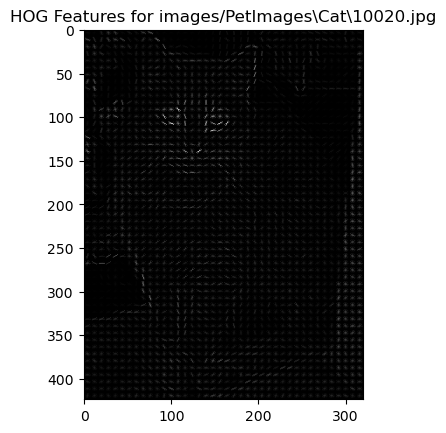

Feature vector for images/PetImages\Cat\10020.jpg: [0.04084307 0.01039599 0.03639926 0.0066142  0.14206521 0.04223127
 0.15702195 0.05175408 0.01996208 0.11044905]


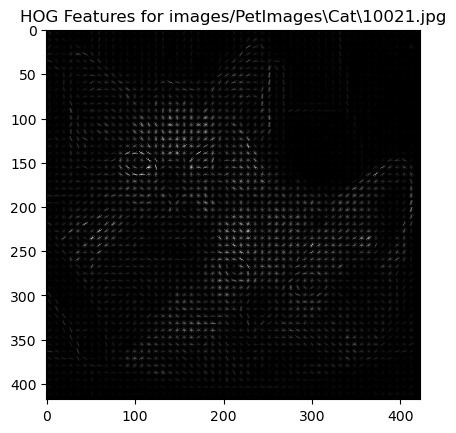

Feature vector for images/PetImages\Cat\10021.jpg: [0.30115643 0.         0.         0.         0.11195679 0.
 0.30912712 0.30912712 0.12993451 0.14045149]


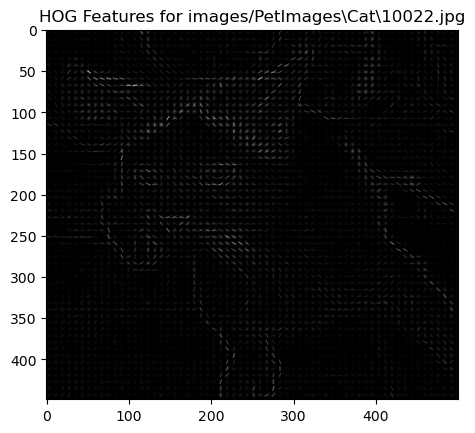

Feature vector for images/PetImages\Cat\10022.jpg: [0.20581325 0.05227316 0.09014255 0.12522024 0.24910844 0.19634923
 0.24910844 0.24910844 0.08252328 0.24910844]


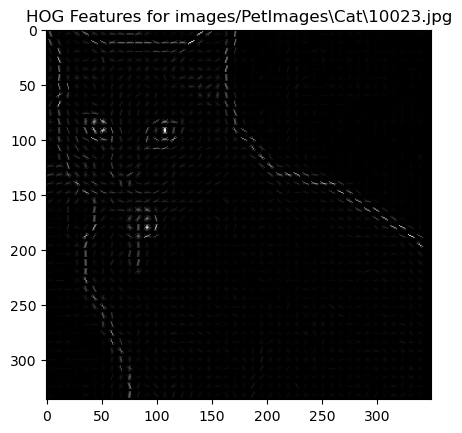

Feature vector for images/PetImages\Cat\10023.jpg: [0.38303592 0.02755963 0.00703936 0.00537335 0.04928771 0.05853712
 0.1064952  0.38303592 0.38303592 0.08389825]


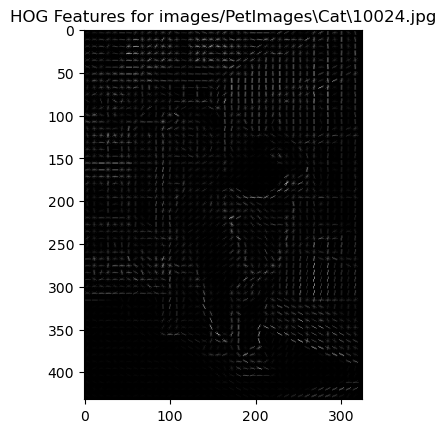

Feature vector for images/PetImages\Cat\10024.jpg: [0.09269826 0.06345556 0.         0.29294706 0.17606267 0.
 0.17436929 0.09244204 0.02817476 0.0627456 ]


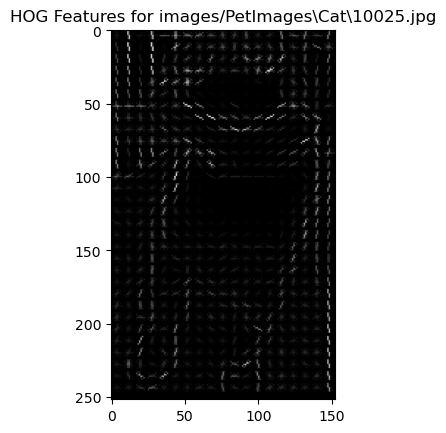

Feature vector for images/PetImages\Cat\10025.jpg: [0.10070809 0.00389173 0.01534908 0.00491207 0.05559821 0.00822656
 0.00390465 0.01001306 0.10688481 0.35453065]


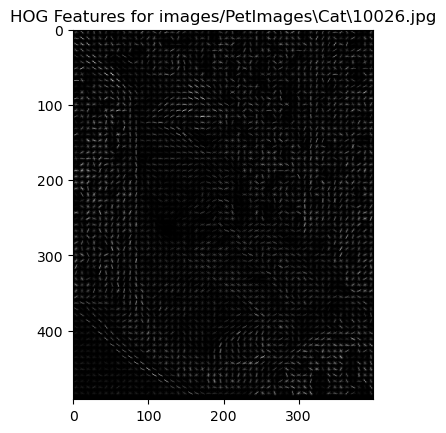

Feature vector for images/PetImages\Cat\10026.jpg: [0.31995512 0.04864351 0.0735614  0.16394343 0.18868513 0.13724435
 0.13497339 0.11690816 0.02982145 0.06148013]


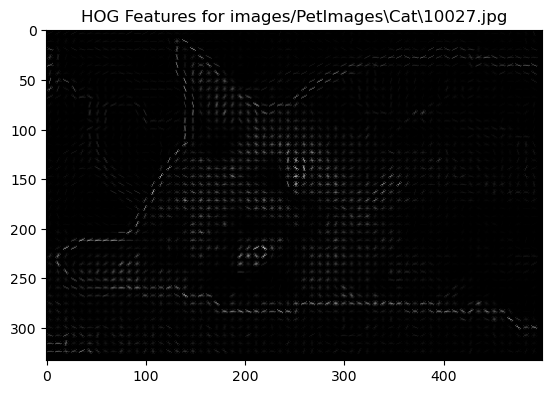

Feature vector for images/PetImages\Cat\10027.jpg: [0.14272532 0.08378348 0.29403197 0.29403197 0.09081352 0.
 0.00917473 0.         0.         0.25079347]


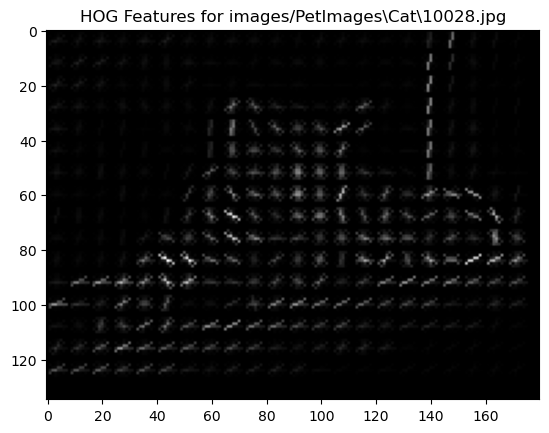

Feature vector for images/PetImages\Cat\10028.jpg: [0.1523479  0.16860104 0.25754664 0.25754664 0.25754664 0.08157086
 0.05779425 0.03028091 0.06179518 0.25754664]


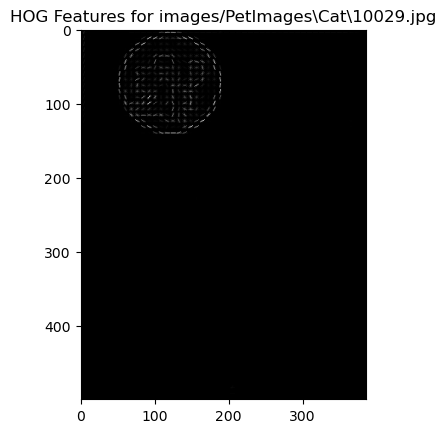

Feature vector for images/PetImages\Cat\10029.jpg: [0.51593347 0.00943268 0.02726722 0.02829948 0.34487302 0.
 0.         0.02237271 0.51593347 0.11262246]


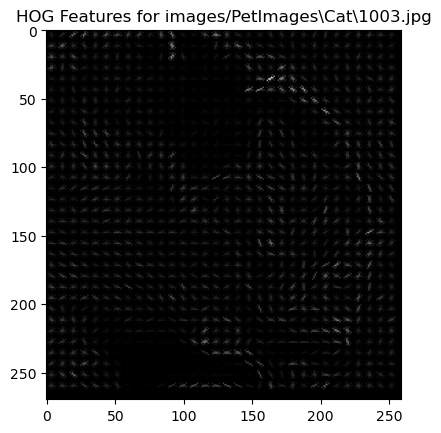

Feature vector for images/PetImages\Cat\1003.jpg: [0.14770685 0.01672671 0.0427166  0.02297322 0.08874839 0.05908727
 0.07158381 0.12938354 0.17406296 0.17056345]


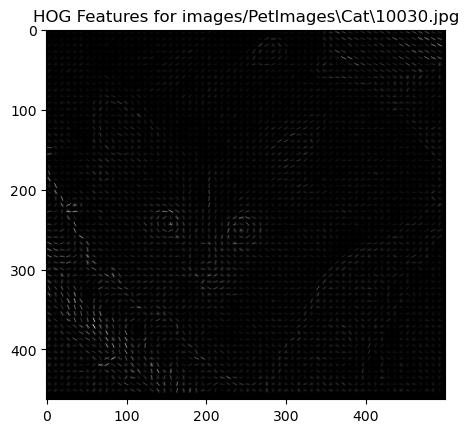

Feature vector for images/PetImages\Cat\10030.jpg: [0.25837212 0.25837212 0.01362837 0.1437778  0.20316853 0.25837212
 0.11651588 0.11258802 0.14055968 0.15263204]


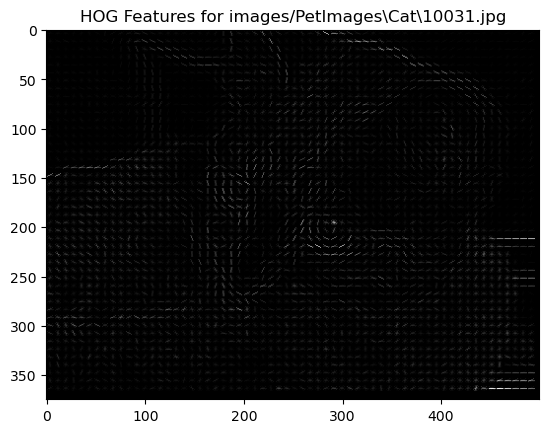

Feature vector for images/PetImages\Cat\10031.jpg: [0.24204479 0.02038881 0.19470215 0.09844591 0.24204479 0.06961177
 0.05158007 0.02038881 0.         0.22795389]


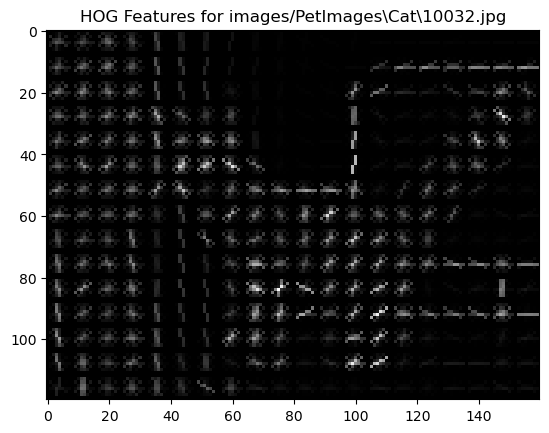

Feature vector for images/PetImages\Cat\10032.jpg: [0.23740216 0.06727401 0.08622439 0.21196234 0.23740216 0.19789329
 0.2121161  0.02209982 0.08253519 0.06437899]


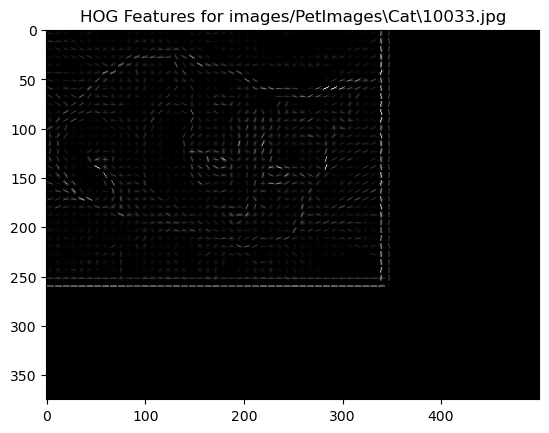

Feature vector for images/PetImages\Cat\10033.jpg: [0.03993567 0.04891682 0.10924819 0.1110807  0.34305847 0.22609238
 0.05843171 0.0280626  0.00785586 0.11874805]


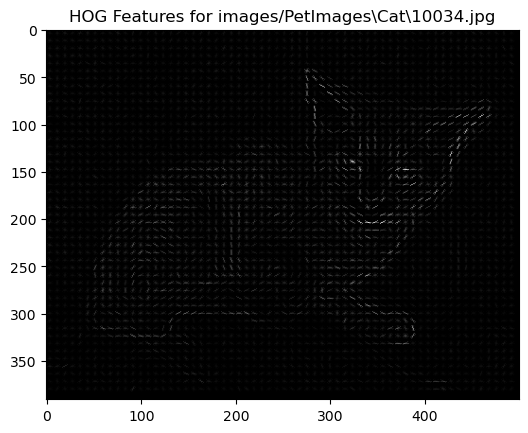

Feature vector for images/PetImages\Cat\10034.jpg: [0.17512306 0.22605244 0.05964859 0.10138623 0.1743375  0.14857739
 0.1970482  0.11442177 0.12611978 0.22859684]


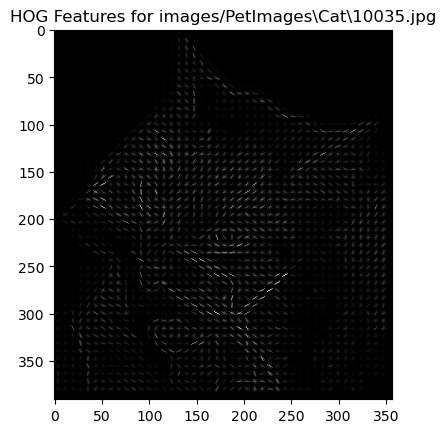

Feature vector for images/PetImages\Cat\10035.jpg: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


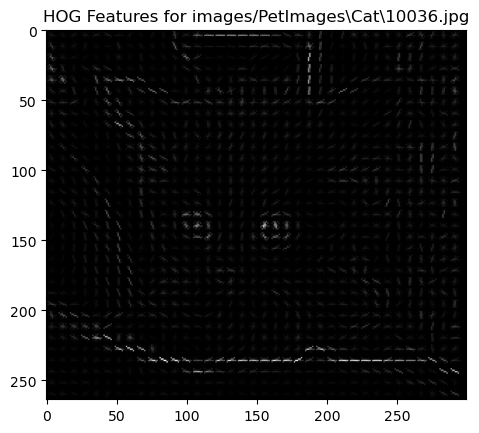

Feature vector for images/PetImages\Cat\10036.jpg: [0.19713651 0.05505537 0.01525427 0.03205628 0.30003812 0.20746678
 0.22706135 0.16884876 0.13669638 0.16475956]


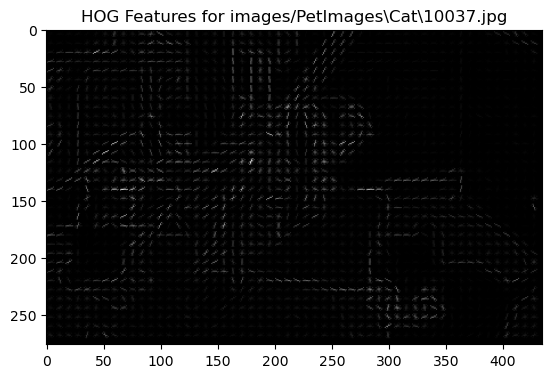

Feature vector for images/PetImages\Cat\10037.jpg: [0.27095702 0.02350997 0.18429129 0.13537402 0.175067   0.13114833
 0.04436341 0.08545839 0.06960924 0.17132284]


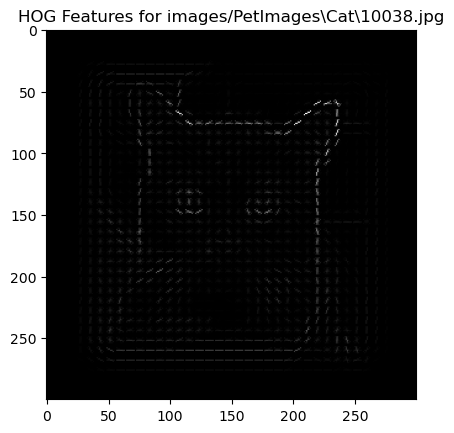

Feature vector for images/PetImages\Cat\10038.jpg: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


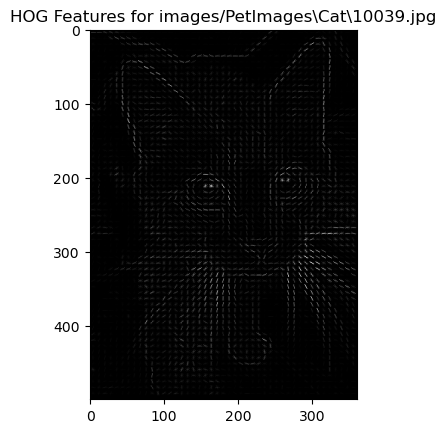

Feature vector for images/PetImages\Cat\10039.jpg: [0.02779636 0.01021661 0.05070274 0.03678727 0.63898305 0.04424654
 0.         0.04783767 0.00926641 0.03736032]


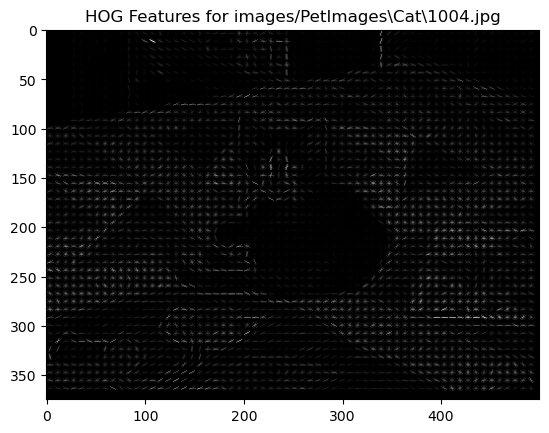

Feature vector for images/PetImages\Cat\1004.jpg: [0.43980609 0.         0.         0.         0.         0.
 0.         0.         0.         0.43980609]


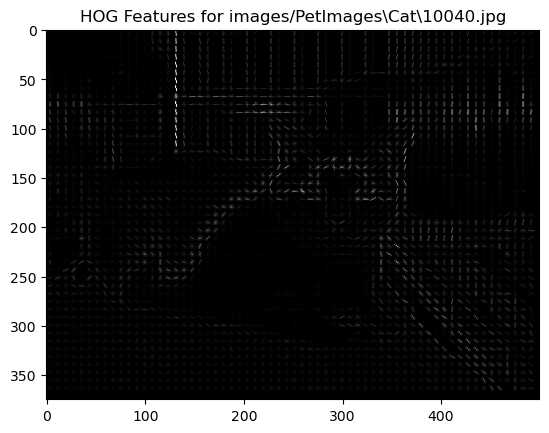

Feature vector for images/PetImages\Cat\10040.jpg: [0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.57735027]


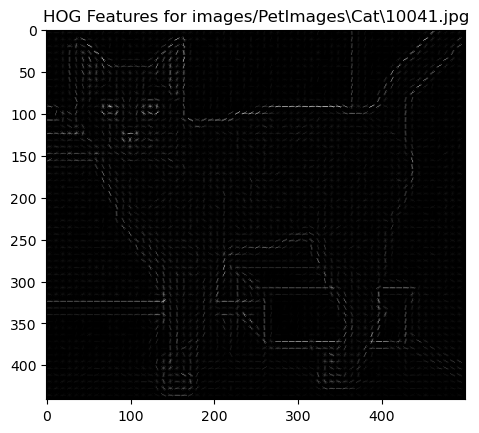

Feature vector for images/PetImages\Cat\10041.jpg: [0.122821   0.         0.10963439 0.25361302 0.3080655  0.15576604
 0.13027133 0.05535467 0.05592487 0.05452733]


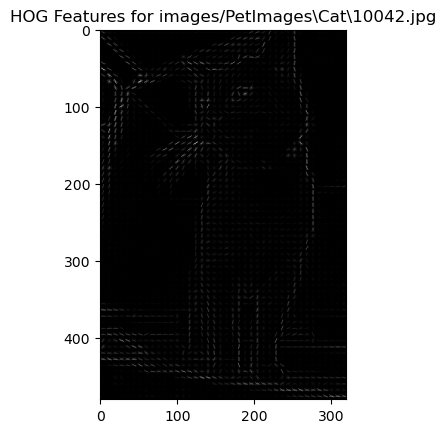

Feature vector for images/PetImages\Cat\10042.jpg: [0.09083017 0.00478339 0.         0.01426251 0.28454257 0.09501973
 0.37917301 0.36337037 0.03486336 0.02608777]


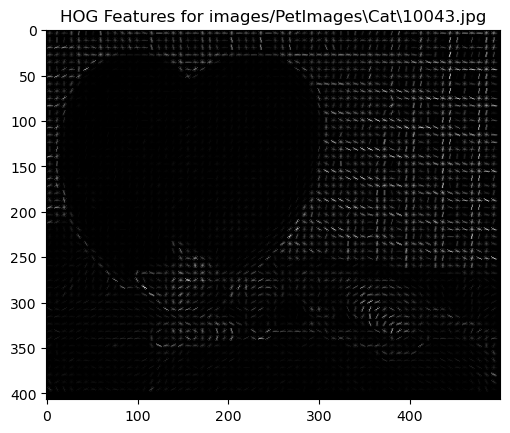

Feature vector for images/PetImages\Cat\10043.jpg: [0.28000543 0.21706953 0.01737518 0.19414113 0.28000543 0.04910509
 0.06983434 0.0689404  0.28000543 0.28000543]


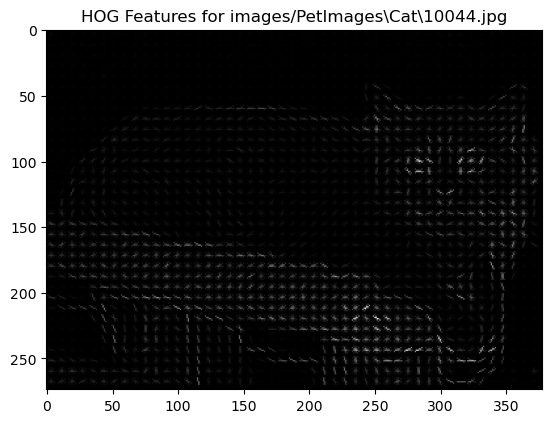

Feature vector for images/PetImages\Cat\10044.jpg: [0.25153813 0.23414323 0.0569383  0.08776796 0.25153813 0.04264277
 0.08764169 0.25153813 0.22677939 0.25153813]


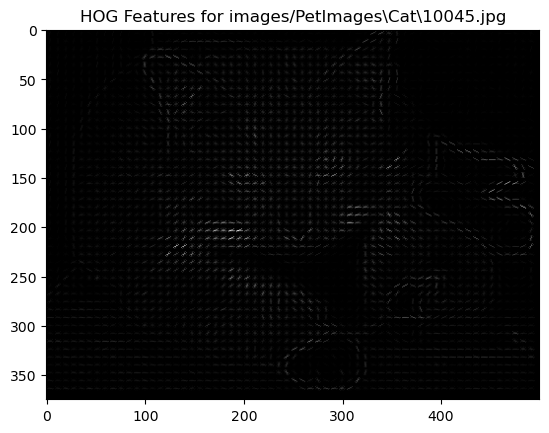

Feature vector for images/PetImages\Cat\10045.jpg: [0.31265307 0.31265307 0.08785056 0.         0.1863592  0.04630131
 0.02928352 0.12095994 0.17364759 0.31265307]


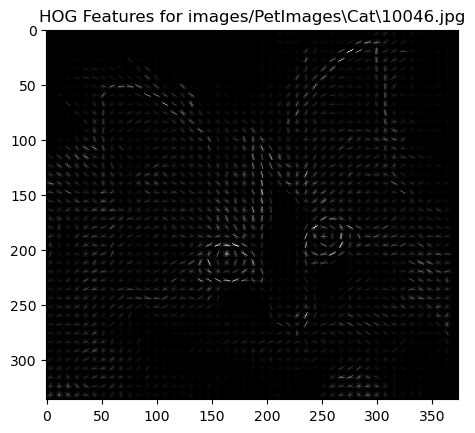

Feature vector for images/PetImages\Cat\10046.jpg: [0.24400711 0.11305514 0.24400711 0.24400711 0.24400711 0.16274552
 0.0660178  0.18568505 0.15640965 0.24400711]


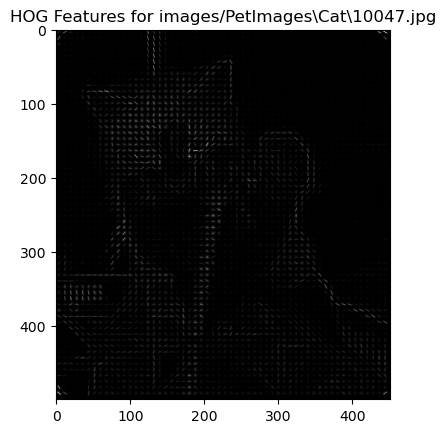

Feature vector for images/PetImages\Cat\10047.jpg: [0.04299999 0.31082427 0.41807621 0.01771022 0.02060196 0.01729495
 0.0083619  0.00514947 0.01025113 0.1201134 ]


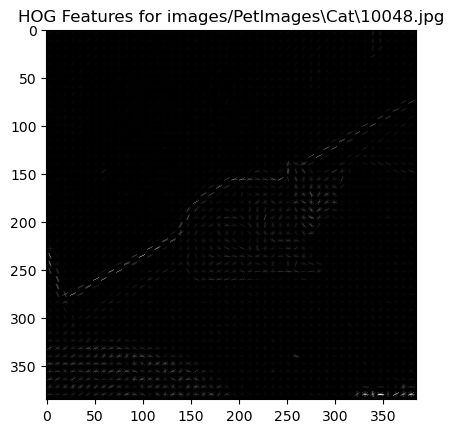

Feature vector for images/PetImages\Cat\10048.jpg: [0.24750908 0.04095789 0.09977111 0.13087406 0.2529539  0.2529539
 0.1084866  0.15371634 0.15295654 0.24792036]


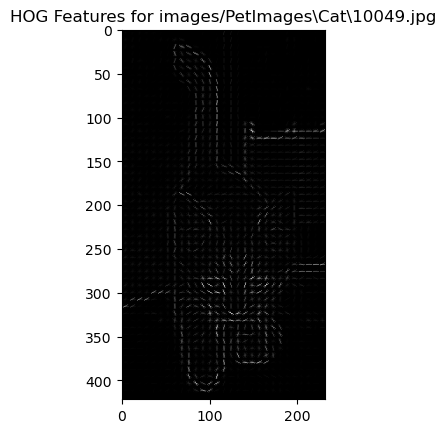

Feature vector for images/PetImages\Cat\10049.jpg: [0.31332449 0.08150276 0.18126474 0.05009455 0.18224571 0.07726214
 0.08591144 0.10867034 0.15368308 0.31332449]


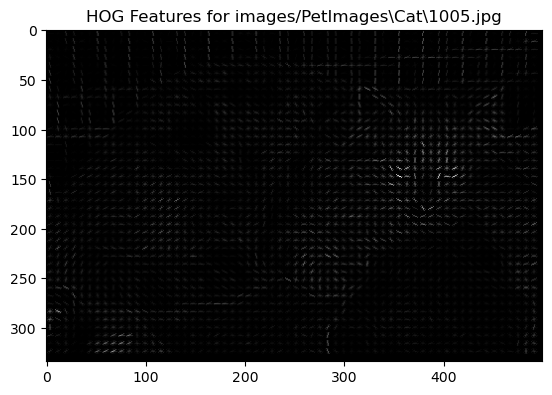

Feature vector for images/PetImages\Cat\1005.jpg: [0.05165055 0.04655717 0.05478368 0.04083334 0.31743385 0.
 0.         0.         0.         0.29667919]


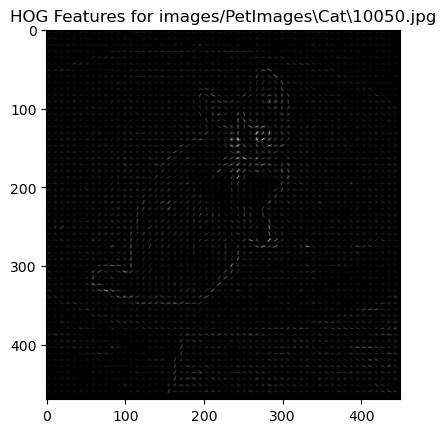

Feature vector for images/PetImages\Cat\10050.jpg: [0.21457915 0.04264717 0.05911354 0.10858615 0.25357492 0.13775277
 0.0909122  0.1875672  0.05812606 0.17646091]


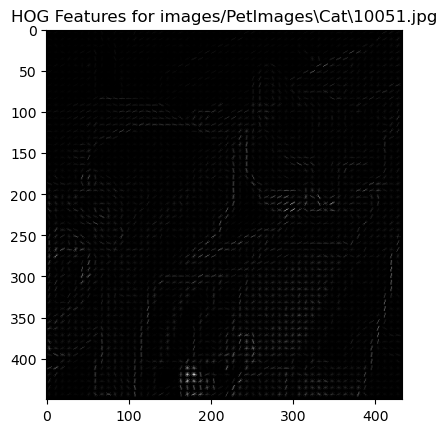

Feature vector for images/PetImages\Cat\10051.jpg: [0.25340349 0.21299788 0.24294706 0.02331487 0.25340349 0.07682604
 0.02960462 0.11693547 0.18165405 0.18174305]


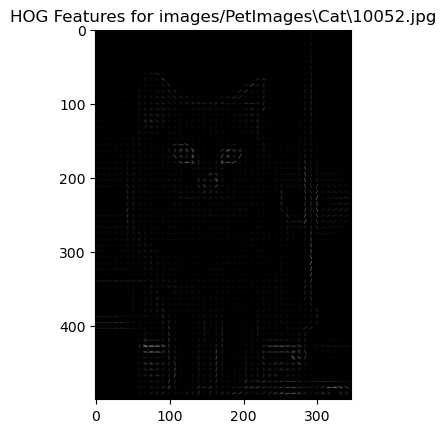

Feature vector for images/PetImages\Cat\10052.jpg: [0.         0.         0.02044916 0.         0.35526279 0.
 0.02272598 0.         0.         0.10427436]


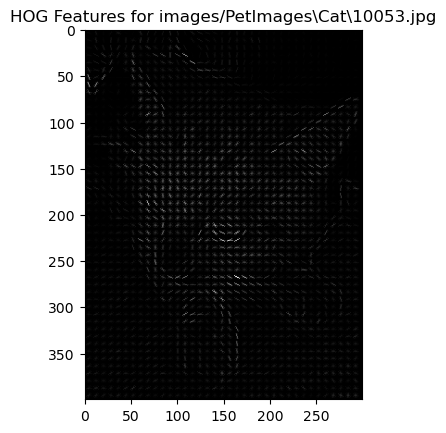

Feature vector for images/PetImages\Cat\10053.jpg: [0.02320193 0.         0.00787074 0.0271184  0.09720904 0.29374476
 0.09424963 0.00639072 0.         0.31857402]


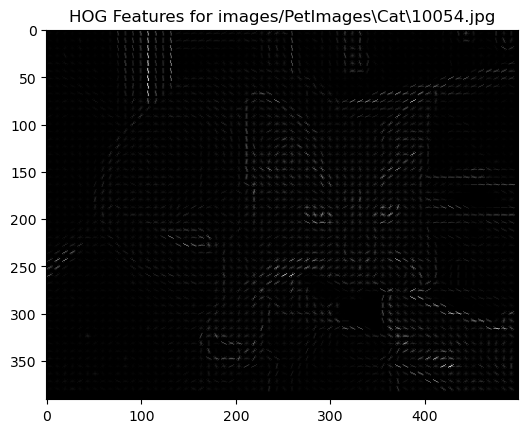

Feature vector for images/PetImages\Cat\10054.jpg: [0.25407768 0.22733436 0.13931468 0.10001466 0.22814031 0.15239586
 0.07151178 0.1331235  0.06084997 0.25407768]


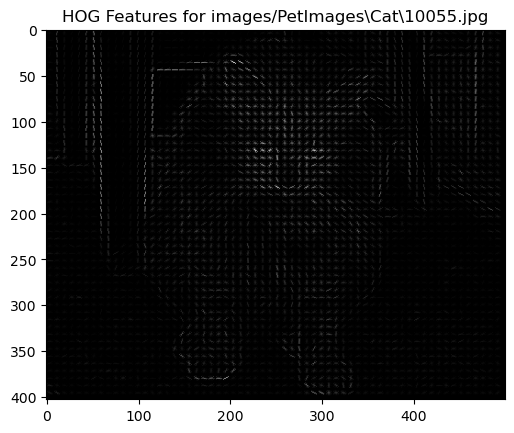

Feature vector for images/PetImages\Cat\10055.jpg: [0.11225265 0.05177932 0.06244993 0.04548781 0.08380228 0.01775308
 0.03843233 0.03667074 0.         0.52186904]


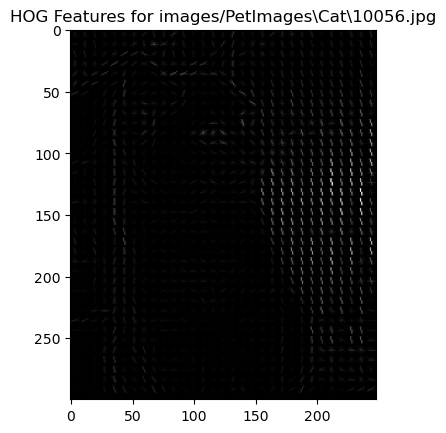

Feature vector for images/PetImages\Cat\10056.jpg: [0.26661598 0.15194243 0.0124194  0.         0.11503233 0.0361332
 0.23194641 0.12316644 0.24688642 0.26661598]


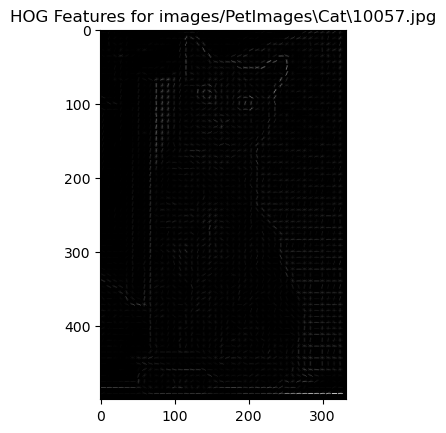

Feature vector for images/PetImages\Cat\10057.jpg: [0.         0.         0.         0.         0.4538251  0.02386897
 0.         0.13396345 0.04401221 0.4538251 ]


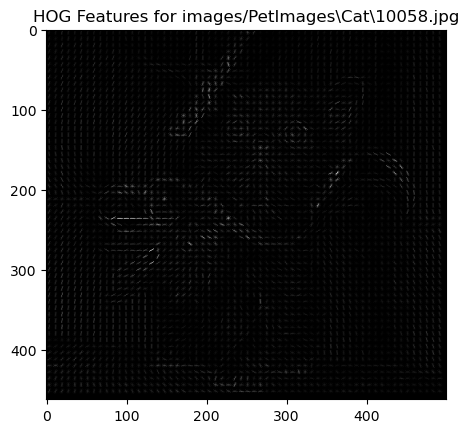

Feature vector for images/PetImages\Cat\10058.jpg: [0.30213546 0.2305293  0.11100775 0.0504254  0.10256019 0.00603504
 0.         0.10312974 0.30213546 0.30213546]


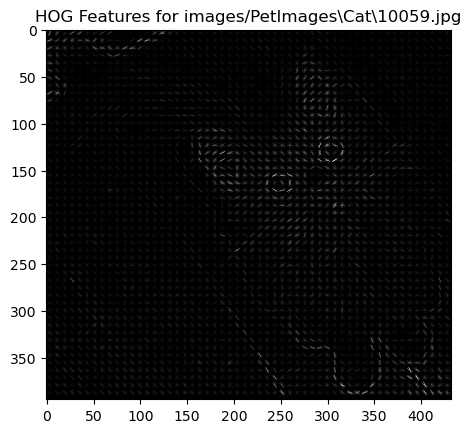

Feature vector for images/PetImages\Cat\10059.jpg: [0.3134372  0.3134372  0.         0.00149689 0.05983546 0.
 0.         0.03762754 0.03534913 0.3134372 ]


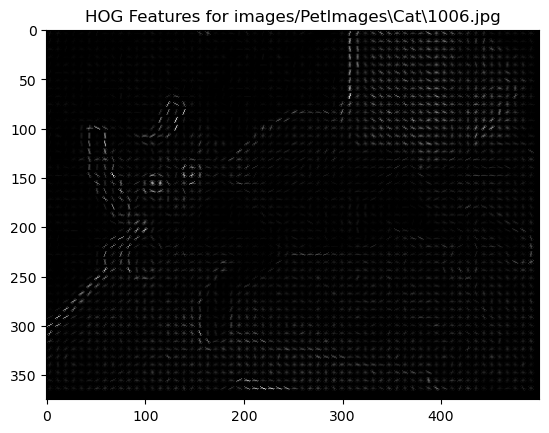

Feature vector for images/PetImages\Cat\1006.jpg: [0.30754579 0.15291699 0.04288467 0.04092491 0.19710627 0.10317709
 0.14526657 0.05085496 0.1656917  0.30754579]


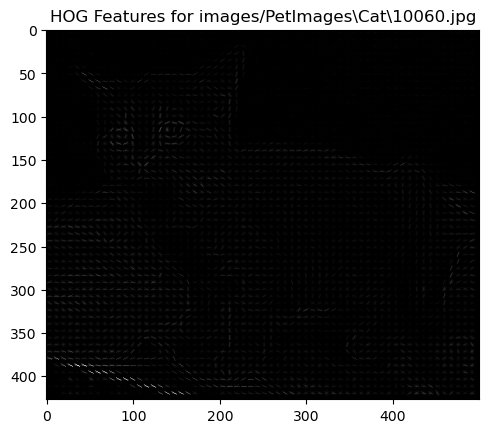

Feature vector for images/PetImages\Cat\10060.jpg: [0.13331698 0.06502925 0.2185166  0.22470628 0.24000596 0.23665264
 0.24000596 0.1159555  0.1808258  0.24000596]


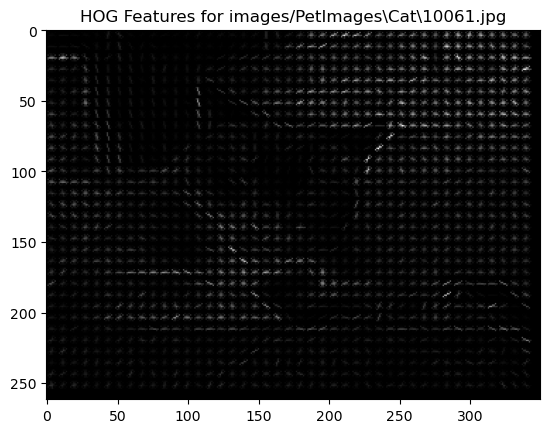

Feature vector for images/PetImages\Cat\10061.jpg: [0.15903566 0.04080759 0.07411729 0.27123847 0.28867435 0.15738658
 0.11470119 0.06754569 0.02887621 0.0344971 ]


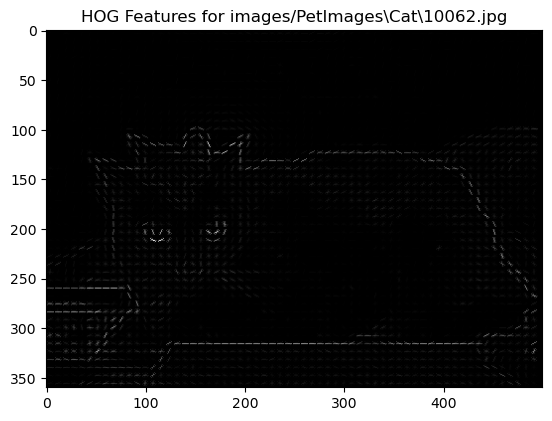

Feature vector for images/PetImages\Cat\10062.jpg: [0.42961951 0.         0.         0.11110343 0.09937394 0.11110343
 0.14053597 0.         0.         0.42961951]


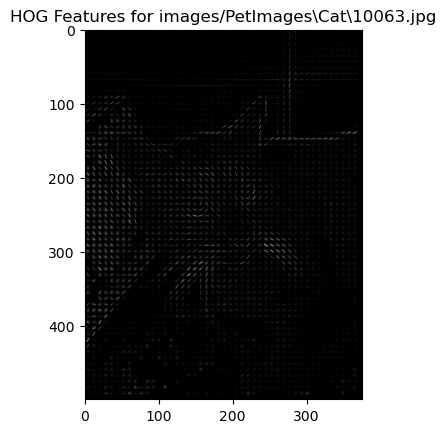

Feature vector for images/PetImages\Cat\10063.jpg: [0.29919906 0.2063408  0.12000203 0.02710569 0.23031868 0.13087787
 0.03428629 0.07081232 0.04998043 0.29919906]


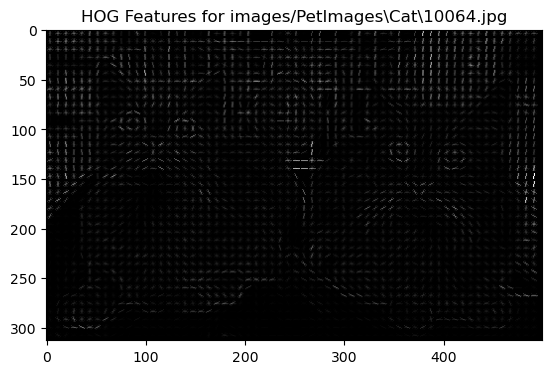

Feature vector for images/PetImages\Cat\10064.jpg: [0.28845341 0.03897568 0.07853481 0.02756649 0.05705222 0.02639414
 0.0312505  0.08175283 0.28845341 0.28845341]


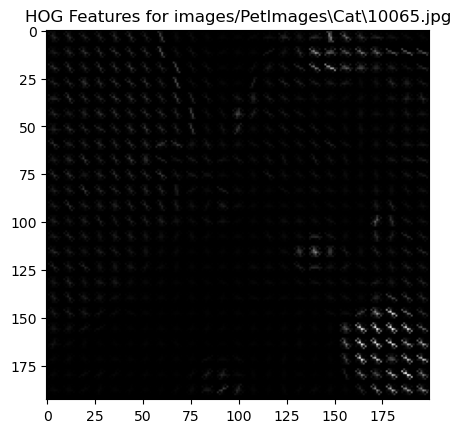

Feature vector for images/PetImages\Cat\10065.jpg: [0.25429733 0.02819948 0.02828027 0.06617845 0.12215795 0.15453256
 0.25429733 0.25429733 0.20720143 0.25429733]


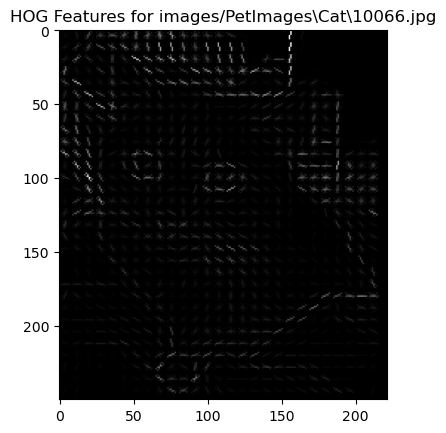

Feature vector for images/PetImages\Cat\10066.jpg: [0.18968618 0.05477475 0.         0.00398922 0.11570813 0.09205965
 0.03771025 0.12941353 0.04980044 0.24532067]


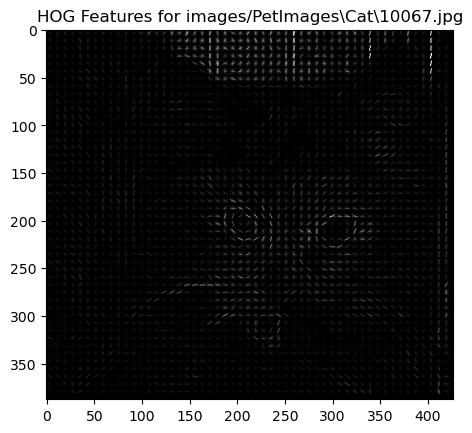

Feature vector for images/PetImages\Cat\10067.jpg: [0.29439714 0.         0.09701228 0.         0.06973684 0.09082284
 0.19923383 0.17781726 0.30967158 0.30967158]


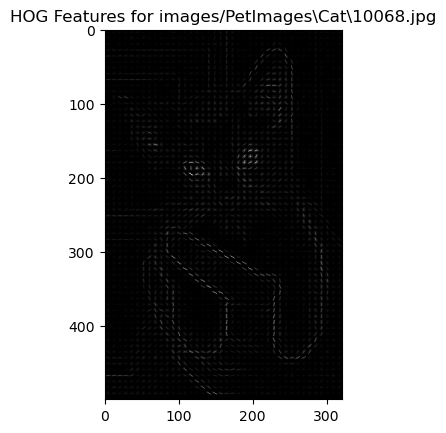

Feature vector for images/PetImages\Cat\10068.jpg: [0.14314508 0.0246217  0.01557213 0.         0.2808535  0.
 0.01557213 0.         0.         0.2808535 ]


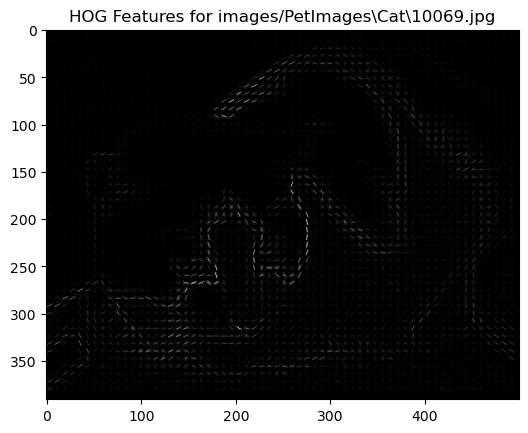

Feature vector for images/PetImages\Cat\10069.jpg: [0.05227947 0.         0.         0.         0.36035727 0.
 0.0985791  0.         0.         0.36035727]


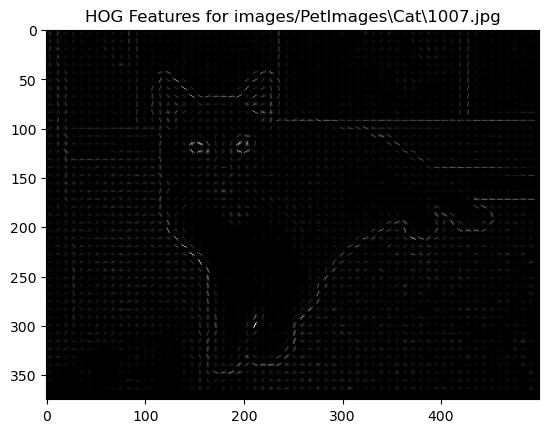

Feature vector for images/PetImages\Cat\1007.jpg: [0.29899809 0.18945257 0.12925169 0.         0.11804    0.00800196
 0.04605926 0.11791813 0.29899809 0.29899809]


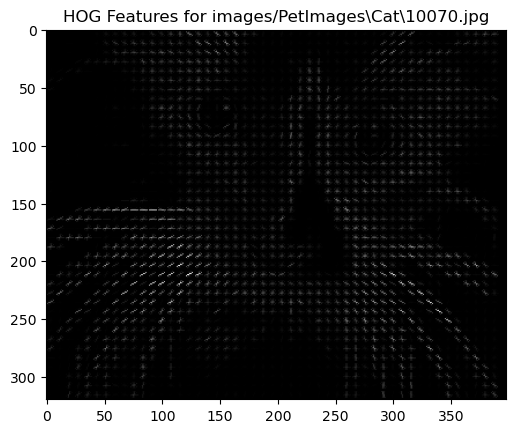

Feature vector for images/PetImages\Cat\10070.jpg: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


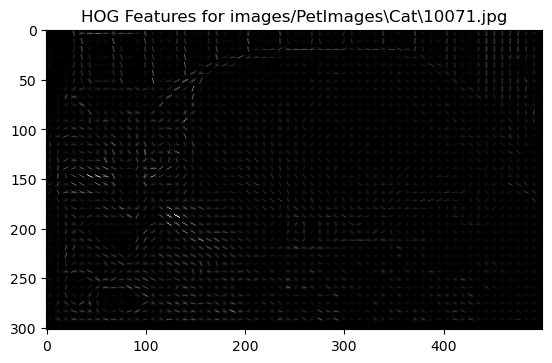

Feature vector for images/PetImages\Cat\10071.jpg: [0.277461   0.13038824 0.19843635 0.277461   0.277461   0.0565375
 0.16090855 0.14770148 0.10444072 0.277461  ]


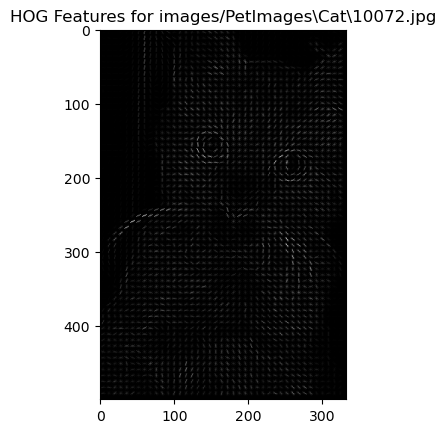

Feature vector for images/PetImages\Cat\10072.jpg: [0.18427931 0.         0.         0.         0.24570574 0.04578456
 0.3364585  0.         0.         0.3364585 ]


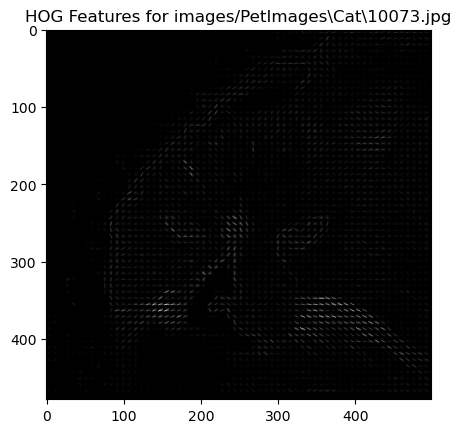

Feature vector for images/PetImages\Cat\10073.jpg: [0.33985008 0.09504554 0.12022416 0.33985008 0.33985008 0.33985008
 0.18033623 0.09504554 0.         0.33985008]


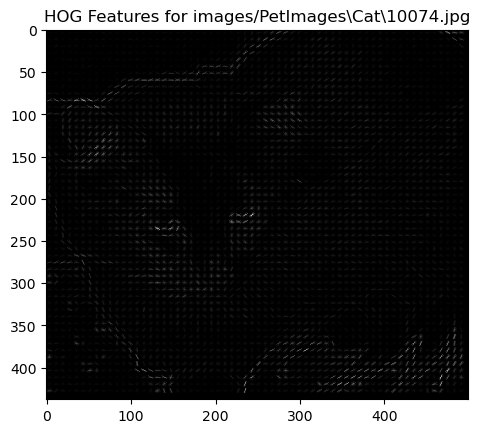

Feature vector for images/PetImages\Cat\10074.jpg: [0.22104634 0.         0.0941283  0.16031853 0.24749119 0.24749119
 0.06252134 0.03954197 0.         0.24749119]


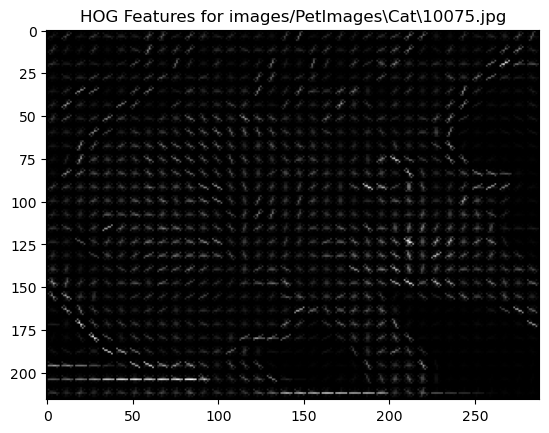

Feature vector for images/PetImages\Cat\10075.jpg: [0.08222904 0.20200724 0.16733519 0.27845803 0.15093381 0.01700886
 0.01357966 0.01861133 0.02061836 0.22772972]


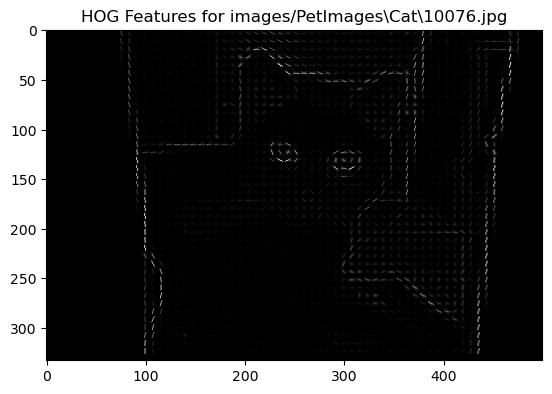

Feature vector for images/PetImages\Cat\10076.jpg: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


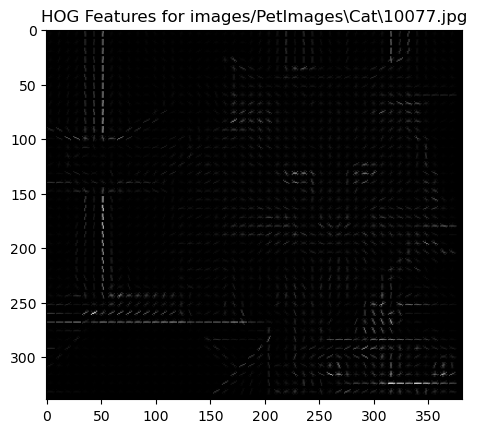

Feature vector for images/PetImages\Cat\10077.jpg: [0.25329164 0.12136848 0.18477819 0.04400505 0.14959981 0.01508175
 0.1001904  0.17601297 0.07530821 0.25329164]


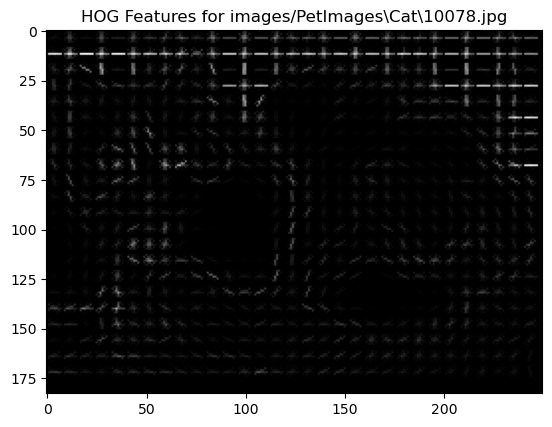

Feature vector for images/PetImages\Cat\10078.jpg: [0.02165594 0.01057747 0.01104224 0.05151163 0.04623005 0.00704437
 0.00224716 0.00678034 0.0012562  0.21887459]


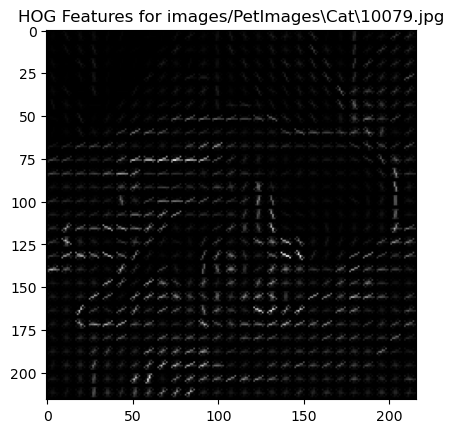

Feature vector for images/PetImages\Cat\10079.jpg: [0.2473843  0.03365418 0.12067684 0.02390741 0.04950415 0.04001416
 0.01992325 0.13695416 0.11712717 0.26441401]


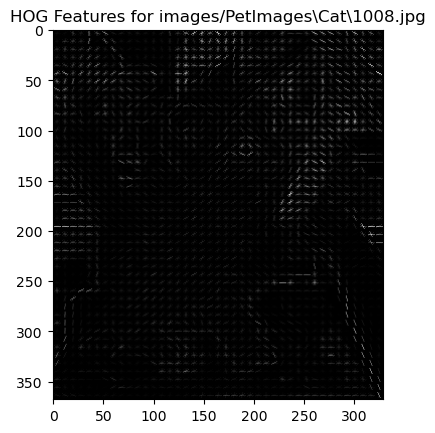

Feature vector for images/PetImages\Cat\1008.jpg: [0.1644925  0.05637271 0.04933248 0.13728152 0.22381159 0.07759163
 0.04857469 0.05036634 0.08514231 0.11027652]


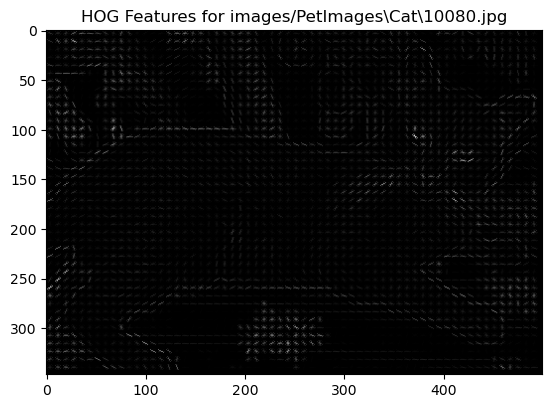

Feature vector for images/PetImages\Cat\10080.jpg: [0.08911274 0.00992684 0.02755163 0.01724105 0.19407535 0.22892874
 0.29240608 0.1425622  0.03722729 0.11193525]


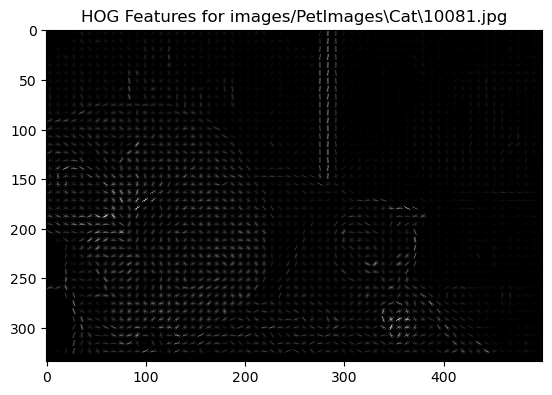

Feature vector for images/PetImages\Cat\10081.jpg: [0.29988604 0.08240747 0.10966622 0.         0.02436021 0.
 0.10132684 0.03010126 0.11719599 0.29988604]


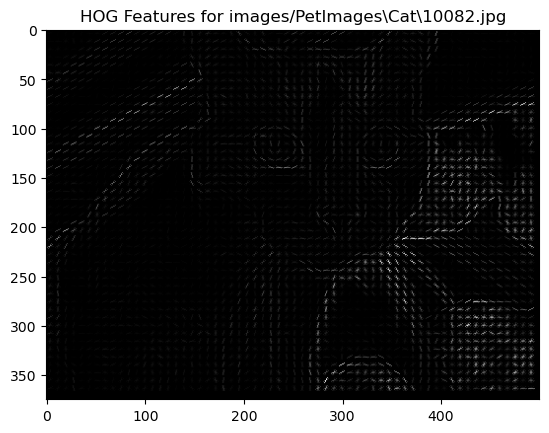

Feature vector for images/PetImages\Cat\10082.jpg: [0.25121365 0.05106643 0.37363068 0.         0.22837605 0.
 0.09689174 0.         0.         0.37363068]


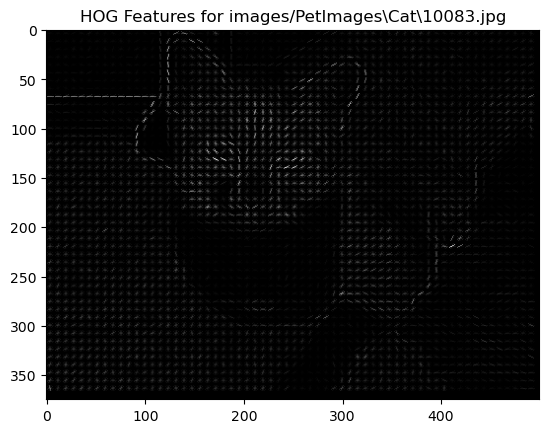

Feature vector for images/PetImages\Cat\10083.jpg: [0.18860198 0.04690767 0.10710034 0.26681114 0.26681114 0.102547
 0.06699396 0.05219521 0.12021077 0.20653308]


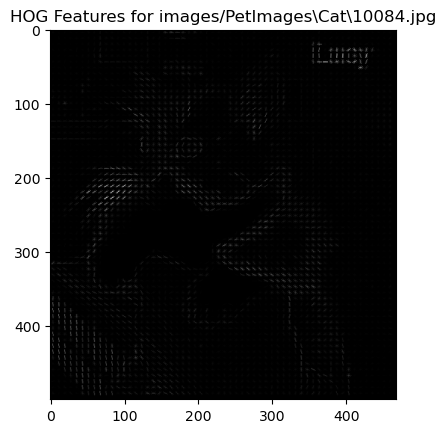

Feature vector for images/PetImages\Cat\10084.jpg: [0.27155922 0.27155922 0.11448311 0.24680795 0.27155922 0.11180851
 0.11588993 0.27155922 0.27155922 0.27155922]


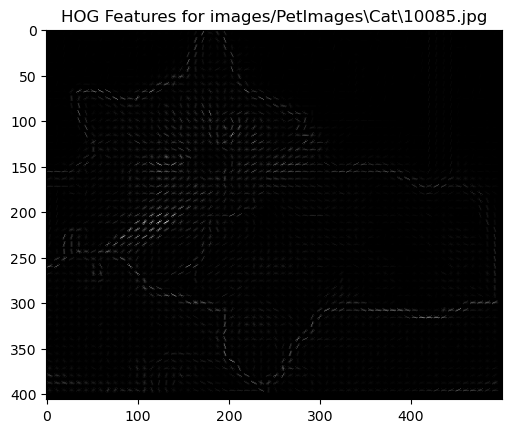

Feature vector for images/PetImages\Cat\10085.jpg: [0.42784554 0.         0.         0.         0.         0.
 0.         0.         0.         0.42784554]


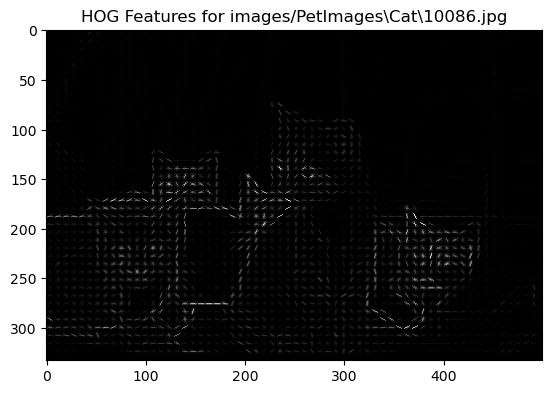

Feature vector for images/PetImages\Cat\10086.jpg: [0.43145417 0.         0.14369041 0.11359724 0.20320893 0.
 0.         0.         0.         0.43145417]


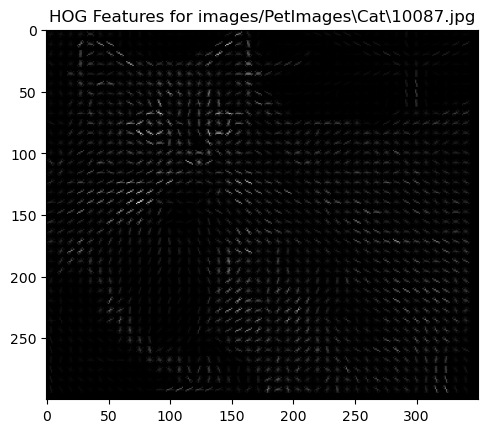

Feature vector for images/PetImages\Cat\10087.jpg: [0.22826207 0.17420625 0.17019459 0.16725588 0.17382781 0.07671947
 0.22826207 0.01843583 0.07552153 0.22826207]


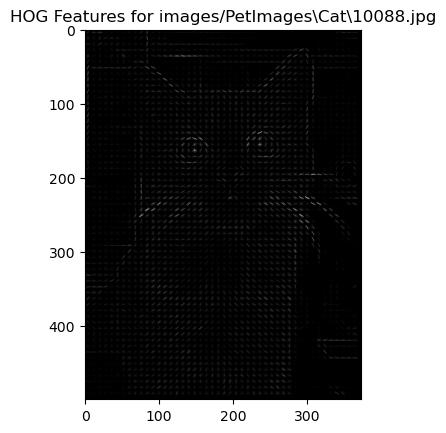

Feature vector for images/PetImages\Cat\10088.jpg: [0.28831395 0.20706708 0.13339552 0.09776313 0.13551054 0.
 0.02884104 0.08270059 0.28831395 0.28831395]


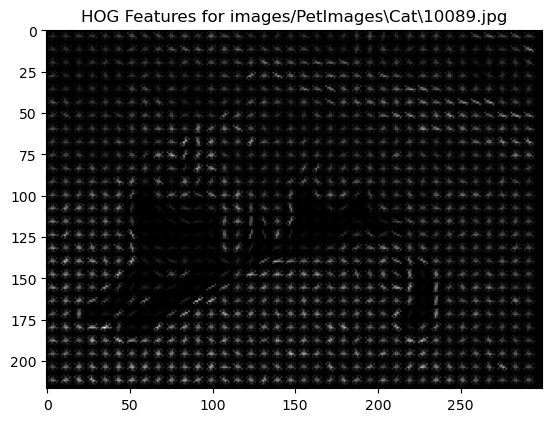

Feature vector for images/PetImages\Cat\10089.jpg: [0.2299053  0.08209649 0.0346249  0.12381758 0.2299053  0.11455784
 0.11483133 0.10965327 0.08446103 0.2299053 ]


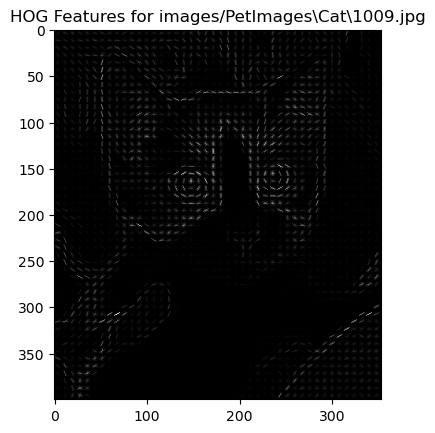

Feature vector for images/PetImages\Cat\1009.jpg: [0.07690728 0.02948962 0.03005437 0.04770281 0.20559807 0.0998665
 0.15111149 0.09976054 0.05224022 0.31863144]


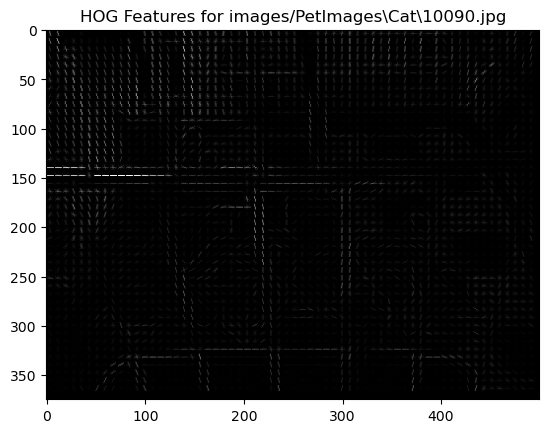

Feature vector for images/PetImages\Cat\10090.jpg: [0.22061165 0.01456806 0.00744848 0.0097969  0.00844785 0.01164242
 0.01413396 0.26408206 0.34664036 0.19358083]


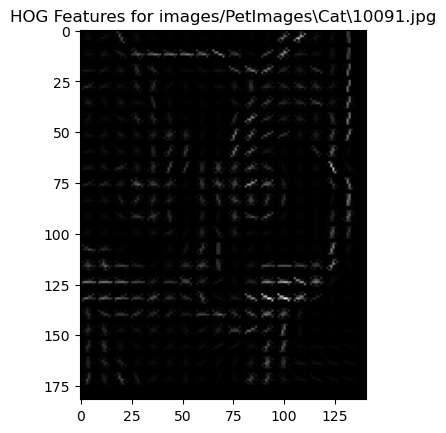

Feature vector for images/PetImages\Cat\10091.jpg: [0.13709581 0.07292967 0.1700998  0.05241024 0.1859789  0.05309748
 0.05453703 0.19555405 0.18380498 0.17225198]


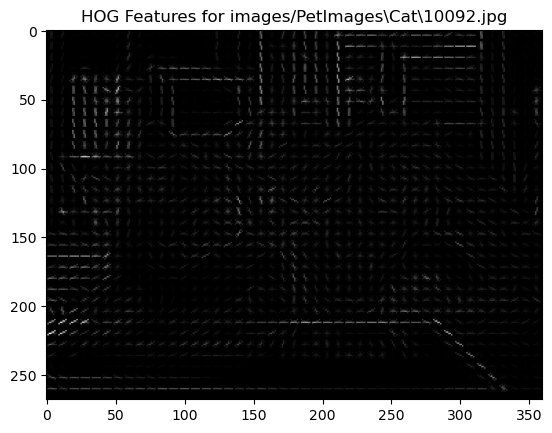

Feature vector for images/PetImages\Cat\10092.jpg: [0.36001172 0.05693597 0.03423564 0.01197081 0.0824572  0.04810693
 0.16026422 0.19211947 0.36001172 0.36001172]


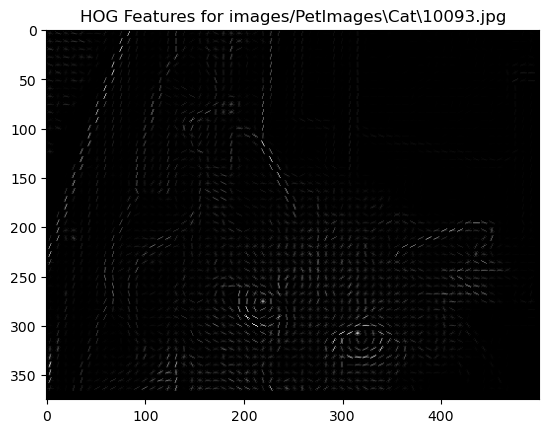

Feature vector for images/PetImages\Cat\10093.jpg: [0.26779674 0.17934466 0.10921977 0.12308533 0.22194704 0.15224001
 0.23235326 0.06001995 0.10318073 0.04163557]


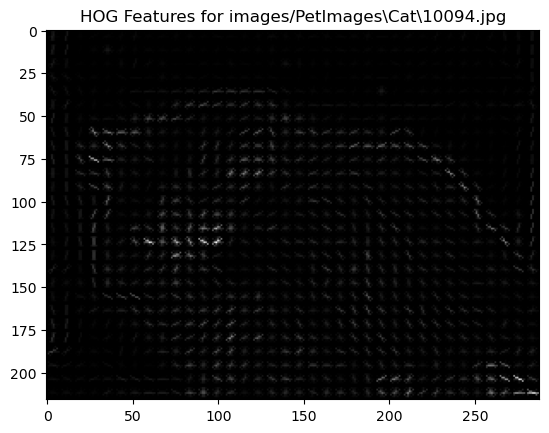

Feature vector for images/PetImages\Cat\10094.jpg: [0.37432305 0.17883096 0.09022946 0.02846971 0.14485062 0.
 0.01576565 0.0626724  0.37432305 0.37432305]


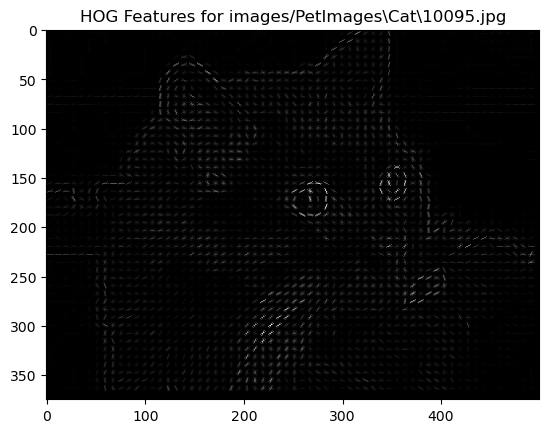

Feature vector for images/PetImages\Cat\10095.jpg: [0.15974873 0.         0.03227412 0.         0.18256999 0.
 0.         0.         0.         0.26614882]


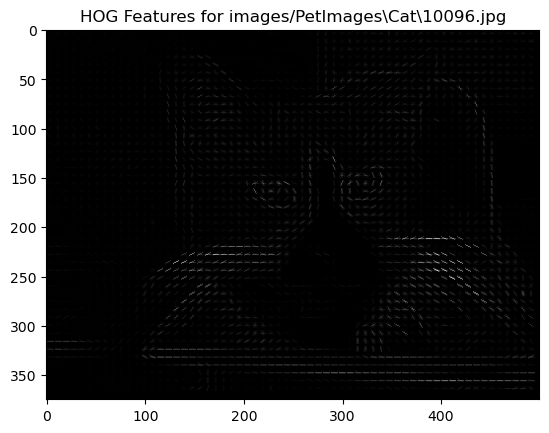

Feature vector for images/PetImages\Cat\10096.jpg: [0.26927114 0.11495569 0.19993701 0.         0.16708168 0.04064298
 0.12723263 0.05747784 0.         0.26927114]


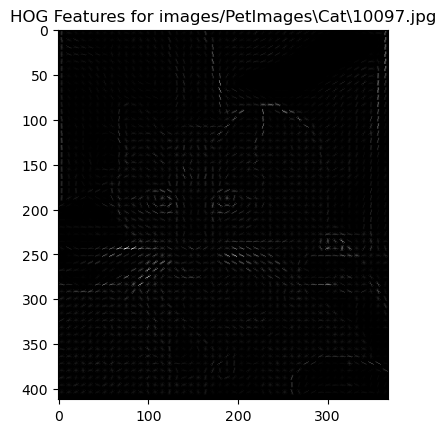

Feature vector for images/PetImages\Cat\10097.jpg: [0.40027631 0.05116315 0.0151171  0.07580781 0.18719753 0.01100773
 0.01403049 0.01680718 0.40027631 0.06424366]


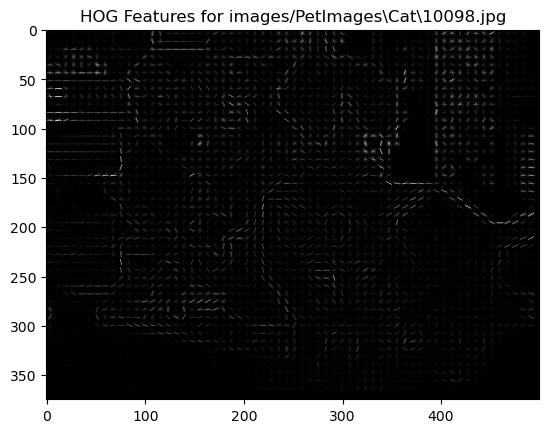

Feature vector for images/PetImages\Cat\10098.jpg: [0.17648346 0.         0.24958532 0.1916722  0.29016404 0.15878645
 0.18718897 0.         0.         0.24340304]


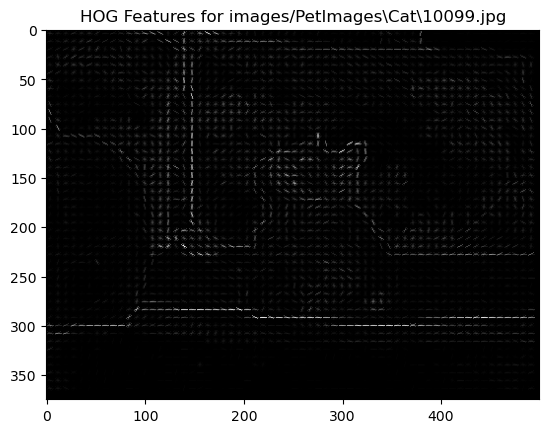

Feature vector for images/PetImages\Cat\10099.jpg: [0.25656201 0.19933367 0.09931149 0.08413547 0.25656201 0.25656201
 0.21781976 0.16406525 0.09429961 0.22890326]


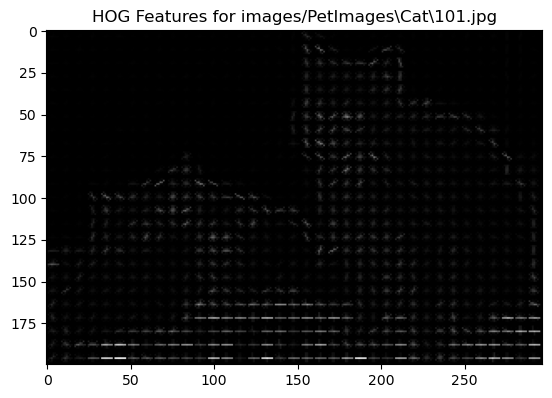

Feature vector for images/PetImages\Cat\101.jpg: [0.29942884 0.12532735 0.10389508 0.17231114 0.29942884 0.14510408
 0.03657966 0.04917974 0.13760162 0.29942884]


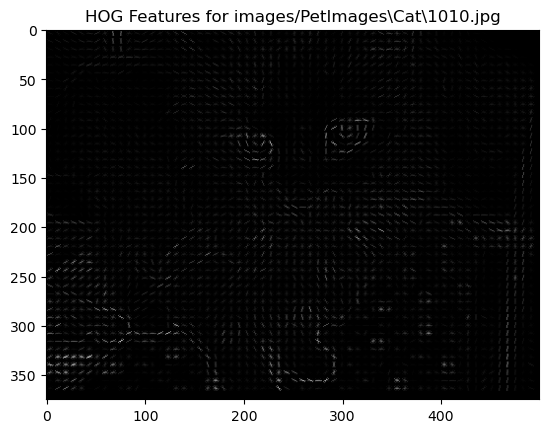

Feature vector for images/PetImages\Cat\1010.jpg: [0.10103911 0.         0.         0.         0.2314403  0.20423069
 0.32499239 0.113686   0.06819063 0.13156768]


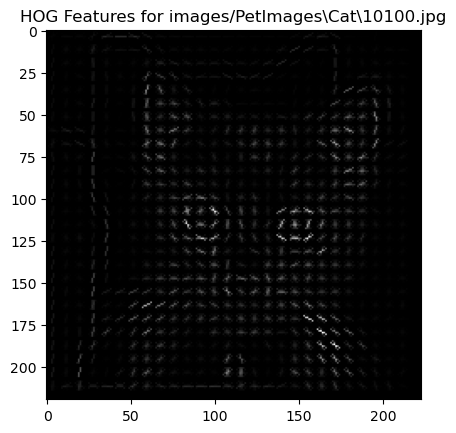

Feature vector for images/PetImages\Cat\10100.jpg: [0.28981473 0.00440908 0.26930161 0.10012761 0.14118069 0.11194724
 0.         0.         0.06078847 0.03959974]


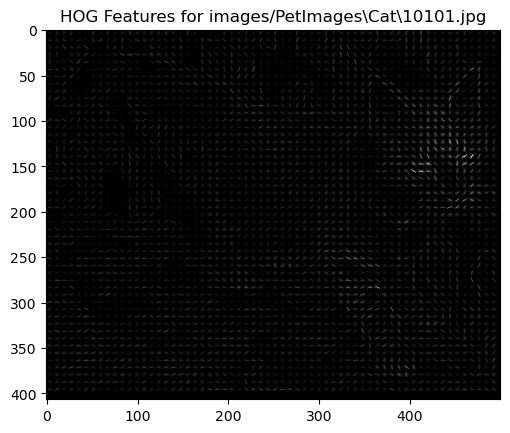

Feature vector for images/PetImages\Cat\10101.jpg: [0.27259421 0.08262912 0.084653   0.         0.13819629 0.08629104
 0.10806908 0.16720103 0.12532599 0.22053727]


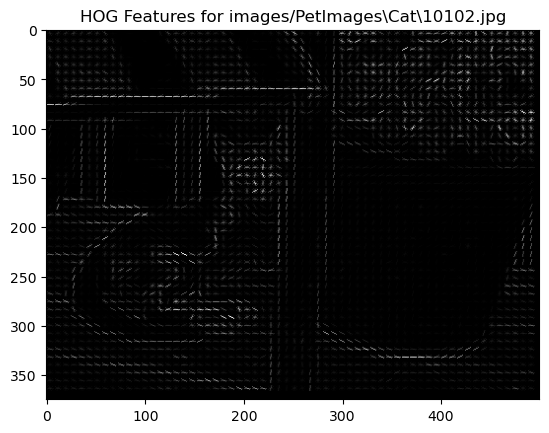

Feature vector for images/PetImages\Cat\10102.jpg: [0.21452695 0.01547006 0.         0.13845091 0.18625945 0.08682169
 0.17088619 0.24101095 0.08130708 0.24101095]


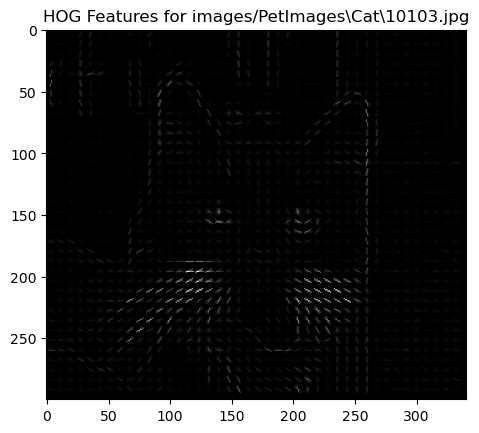

Feature vector for images/PetImages\Cat\10103.jpg: [0.11659019 0.07821819 0.05759078 0.07548933 0.10808146 0.16199176
 0.19174681 0.16954446 0.1535972  0.23442022]


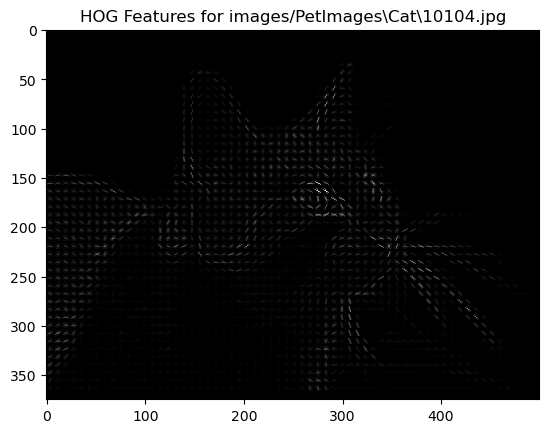

Feature vector for images/PetImages\Cat\10104.jpg: [0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]


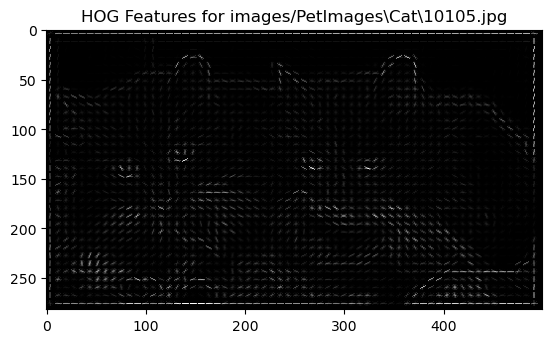

Feature vector for images/PetImages\Cat\10105.jpg: [0.17796376 0.02298302 0.2137093  0.07542111 0.13344946 0.00185492
 0.         0.00761931 0.02853076 0.01436258]


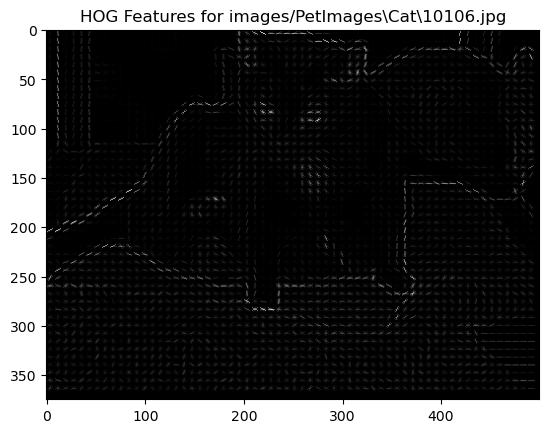

Feature vector for images/PetImages\Cat\10106.jpg: [0.12349734 0.         0.         0.00655063 0.00603912 0.00492818
 0.00569974 0.05999644 0.11971021 0.53346326]


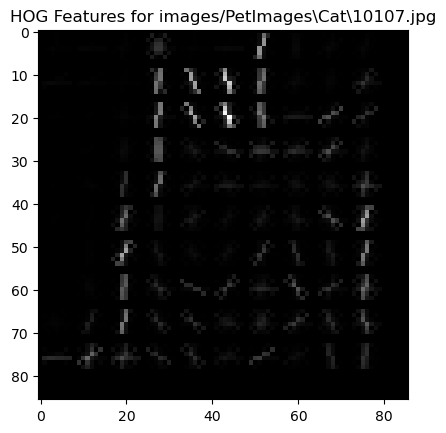

Feature vector for images/PetImages\Cat\10107.jpg: [0.25120187 0.13950615 0.12927446 0.0681108  0.27462696 0.03175082
 0.00447384 0.02067564 0.07589991 0.02443932]


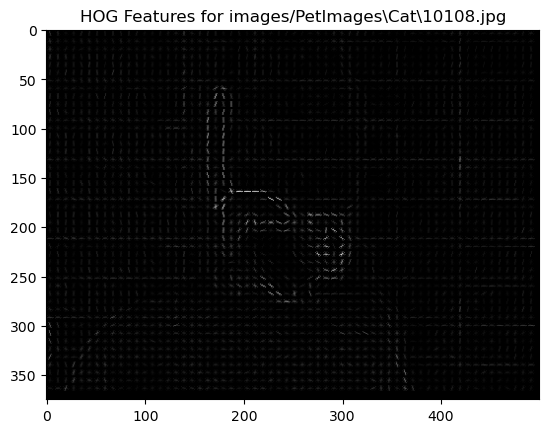

Feature vector for images/PetImages\Cat\10108.jpg: [0.24684244 0.05307825 0.02060284 0.0232784  0.07468488 0.
 0.         0.28625489 0.28625489 0.28625489]


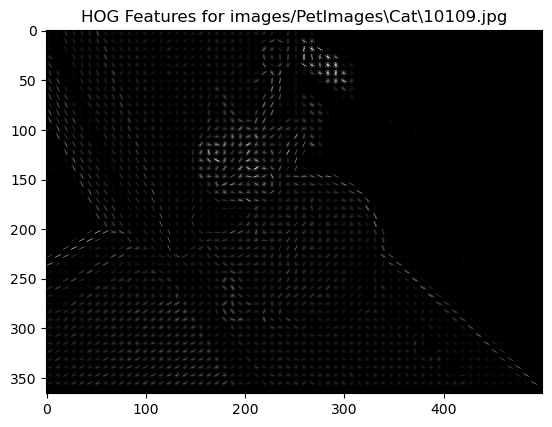

Feature vector for images/PetImages\Cat\10109.jpg: [0.32696099 0.14282886 0.15888926 0.02361834 0.15898609 0.
 0.05287854 0.13907987 0.09059279 0.32696099]


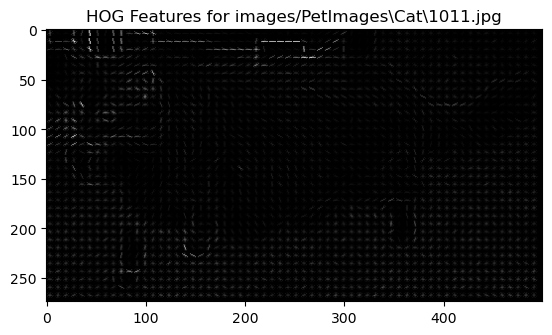

Feature vector for images/PetImages\Cat\1011.jpg: [0.35173433 0.15709704 0.30886136 0.11643671 0.14352419 0.02785863
 0.01489785 0.10271631 0.35173433 0.02304434]


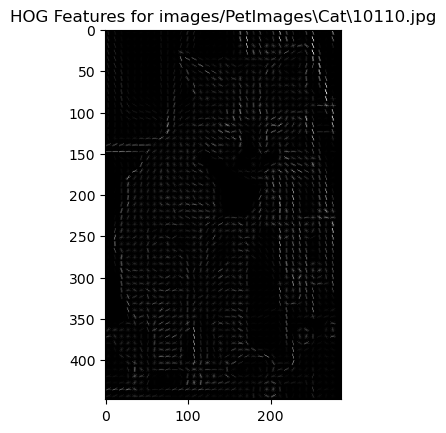

Feature vector for images/PetImages\Cat\10110.jpg: [0.22255765 0.         0.         0.         0.05088565 0.
 0.         0.08819241 0.38282668 0.23146255]


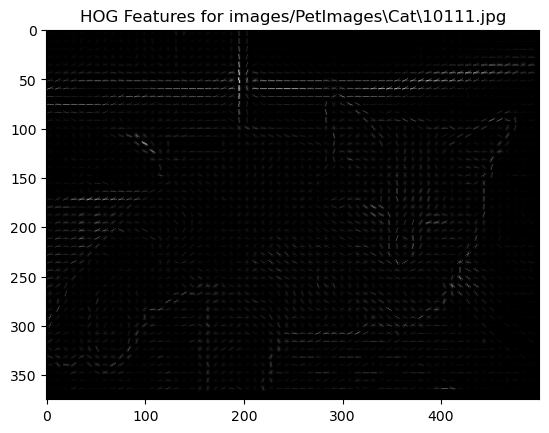

Feature vector for images/PetImages\Cat\10111.jpg: [0.         0.         0.         0.         0.33276271 0.
 0.         0.         0.         0.        ]


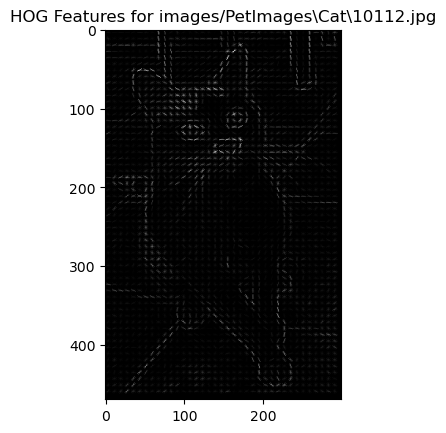

Feature vector for images/PetImages\Cat\10112.jpg: [0.0533348  0.02916703 0.03997435 0.26837916 0.28118119 0.27914444
 0.15594351 0.07106194 0.01900724 0.01759324]


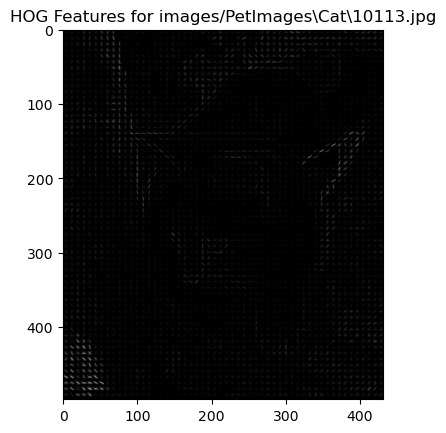

Feature vector for images/PetImages\Cat\10113.jpg: [0.18865408 0.03274728 0.03187225 0.01238003 0.10339457 0.14971896
 0.07919398 0.1937069  0.20352996 0.28256018]


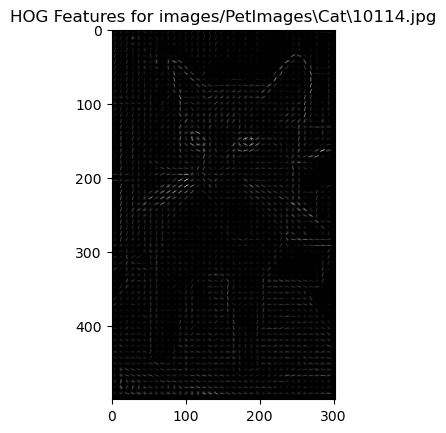

Feature vector for images/PetImages\Cat\10114.jpg: [0.42848344 0.01586999 0.00955269 0.         0.04198342 0.01442517
 0.00531651 0.         0.07254199 0.42848344]


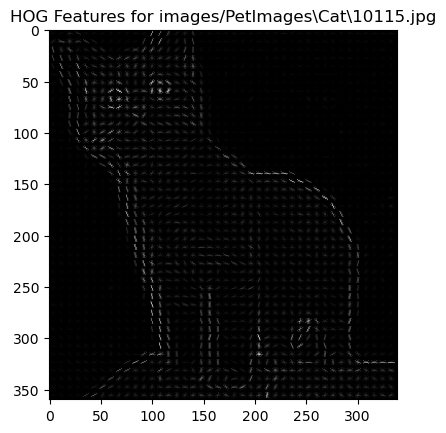

Feature vector for images/PetImages\Cat\10115.jpg: [0.04096218 0.05590837 0.07415387 0.13645863 0.1260629  0.04235532
 0.         0.02388289 0.01501347 0.03294862]


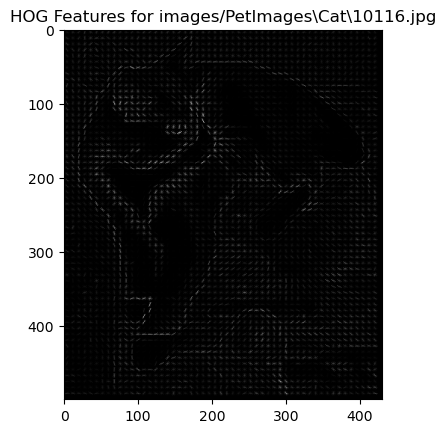

Feature vector for images/PetImages\Cat\10116.jpg: [0.15354672 0.05633648 0.14274338 0.0296081  0.14504983 0.0570448
 0.23345338 0.09787506 0.11753691 0.23345338]


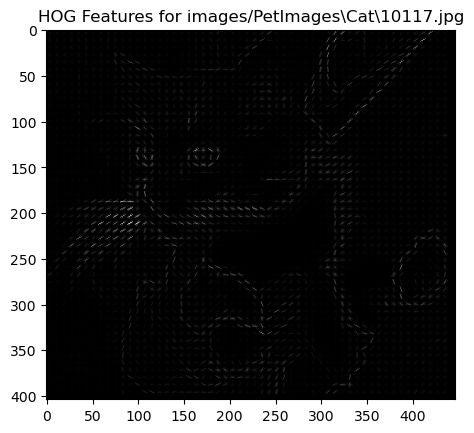

Feature vector for images/PetImages\Cat\10117.jpg: [0.24842013 0.15205686 0.13048488 0.09739085 0.20944953 0.03507859
 0.07097277 0.24842013 0.09744509 0.24842013]


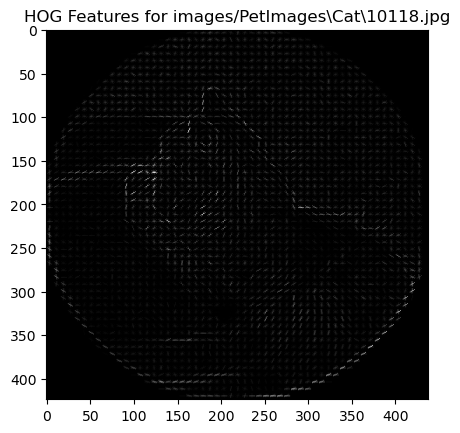

Feature vector for images/PetImages\Cat\10118.jpg: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


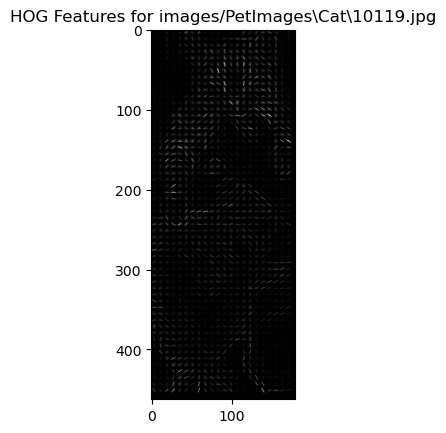

Feature vector for images/PetImages\Cat\10119.jpg: [0.27309965 0.13482752 0.27309965 0.24658638 0.27309965 0.05984468
 0.25366077 0.13293983 0.0393384  0.27309965]


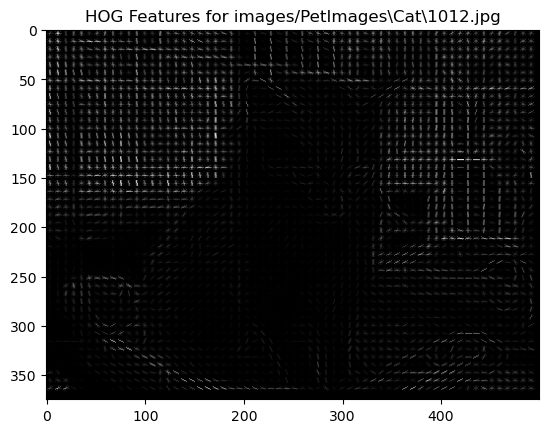

Feature vector for images/PetImages\Cat\1012.jpg: [0.22373774 0.08819934 0.10401078 0.01122468 0.15975134 0.01065365
 0.01220117 0.00432523 0.07054546 0.2373086 ]


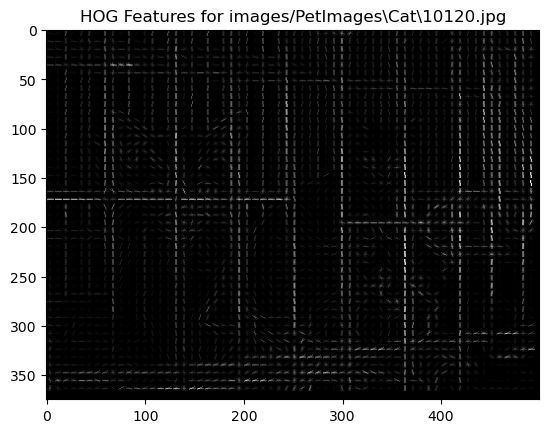

Feature vector for images/PetImages\Cat\10120.jpg: [0.06641333 0.03419145 0.02212604 0.04703136 0.387427   0.27252526
 0.02874811 0.0264152  0.01844432 0.15622641]


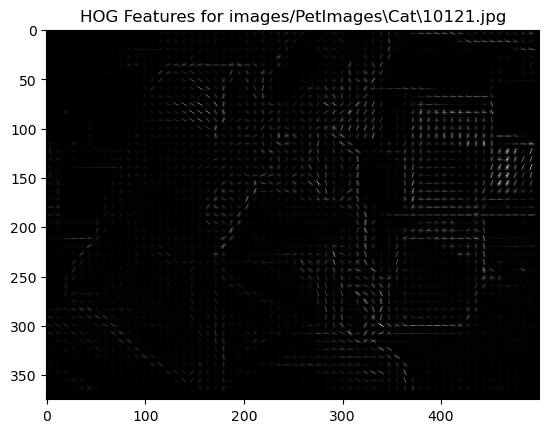

Feature vector for images/PetImages\Cat\10121.jpg: [0.18877899 0.         0.34940395 0.04690251 0.25170531 0.
 0.         0.         0.         0.23072987]


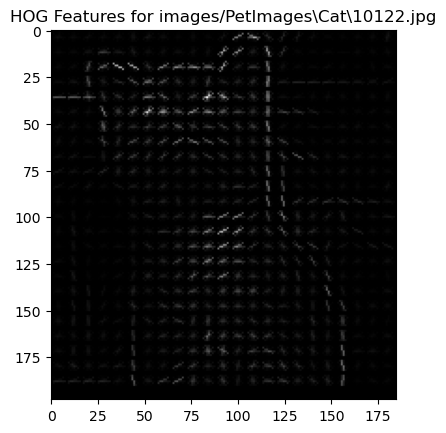

Feature vector for images/PetImages\Cat\10122.jpg: [0.23848021 0.20714732 0.17729308 0.10030578 0.23848021 0.23848021
 0.1668095  0.00611379 0.1077692  0.23848021]


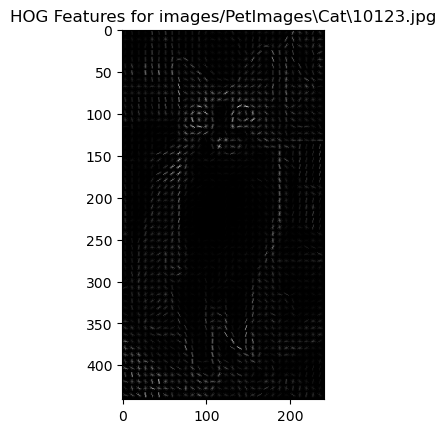

Feature vector for images/PetImages\Cat\10123.jpg: [0.31757453 0.         0.00968235 0.         0.03080905 0.
 0.00484117 0.02608921 0.31757453 0.31757453]


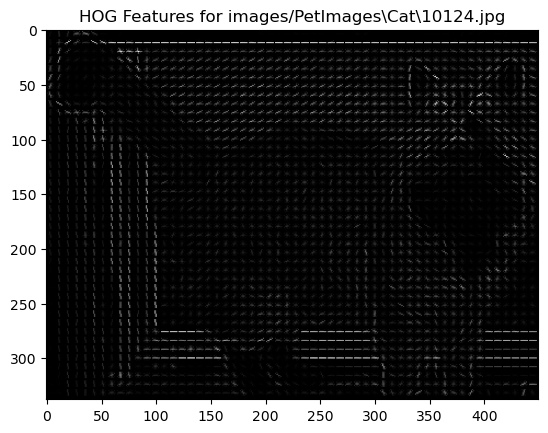

Feature vector for images/PetImages\Cat\10124.jpg: [0.33246485 0.0402074  0.         0.00446749 0.03196675 0.02154461
 0.01549912 0.04498158 0.02234032 0.36042256]


ValueError: Only images with two spatial dimensions are supported. If using with color/multichannel images, specify `channel_axis`.

In [43]:
# Step 7: Test feature extraction on the images
test_feature_extraction(image_paths)